In [529]:
import numpy as np
import networkx as nx
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import scipy.io
import networkx.algorithms.community as nx_com
from networkx.algorithms.community.centrality import girvan_newman

In [ ]:
## question 1) done

In [330]:
#get adjecency matrix from .mat file
A = min_mat['A'].todense()

In [47]:
# this is incorrect not using A, adjecency matrix
#graph5 = nx.Graph()
#for n in min_mat['xy']:
#    graph5.add_edge(n[0],n[1])

In [434]:
graph1 = nx.erdos_renyi_graph(100,0.3)
graph2 = nx.barabasi_albert_graph(100,2)
graph3 = nx.barbell_graph(45,10)
graph4 = nx.les_miserables_graph()
graph5 = nx.from_numpy_array(A) #nx.read_edgelist(min_mat['xy'],create_using=nx.DiGraph, delimiter=",", nodetype=int)

In [410]:
def les_plotter(graph):
    plt.figure(1,figsize=(10,10))
    mappable = plt.cm.ScalarMappable(cmap = plt.cm.jet, norm = plt.Normalize( vmin = min(nx.get_node_attributes(graph, 'color').values()), vmax = max(nx.get_node_attributes(graph, 'color').values())))
    nx.draw(graph,pos=None,with_labels=False,node_size=50, cmap = plt.cm.jet ,node_color=list(nx.get_node_attributes(graph, 'color').values()),width=0.1)
    plt.colorbar(mappable)

In [411]:
def graph_plotter(graph, clist):
    plt.figure(1,figsize=(10,10))
    mappable = plt.cm.ScalarMappable(cmap = plt.cm.jet, norm = plt.Normalize( vmin = min(clist), vmax = max(clist)))
    nx.draw(graph,pos=None,with_labels=False,node_size=50, cmap = plt.cm.jet ,node_color=clist,width=0.1)
    plt.colorbar(mappable)

In [417]:
#) compute betweeness lists and color lists
betweenness_list1 = nx.betweenness_centrality(graph1)
bcolor1 = [betweenness_list1[i] for i in range(len(betweenness_list1))]
betweenness_list2 = nx.betweenness_centrality(graph2)
bcolor2 = [betweenness_list2[i] for i in range(len(betweenness_list2))]
betweenness_list3 = nx.betweenness_centrality(graph3)
bcolor3 = [betweenness_list3[i] for i in range(len(betweenness_list3))]
betweenness_list4 = nx.betweenness_centrality(graph4) # use les graph plotter

# we need to do this so attributes are set in les graph
# for respective centrality measure
nx.set_node_attributes(graph4,betweenness_list4,name='color') 



betweenness_list5 = nx.betweenness_centrality(graph5)
bcolor5 = [betweenness_list5[i] for i in range(len(betweenness_list5))]

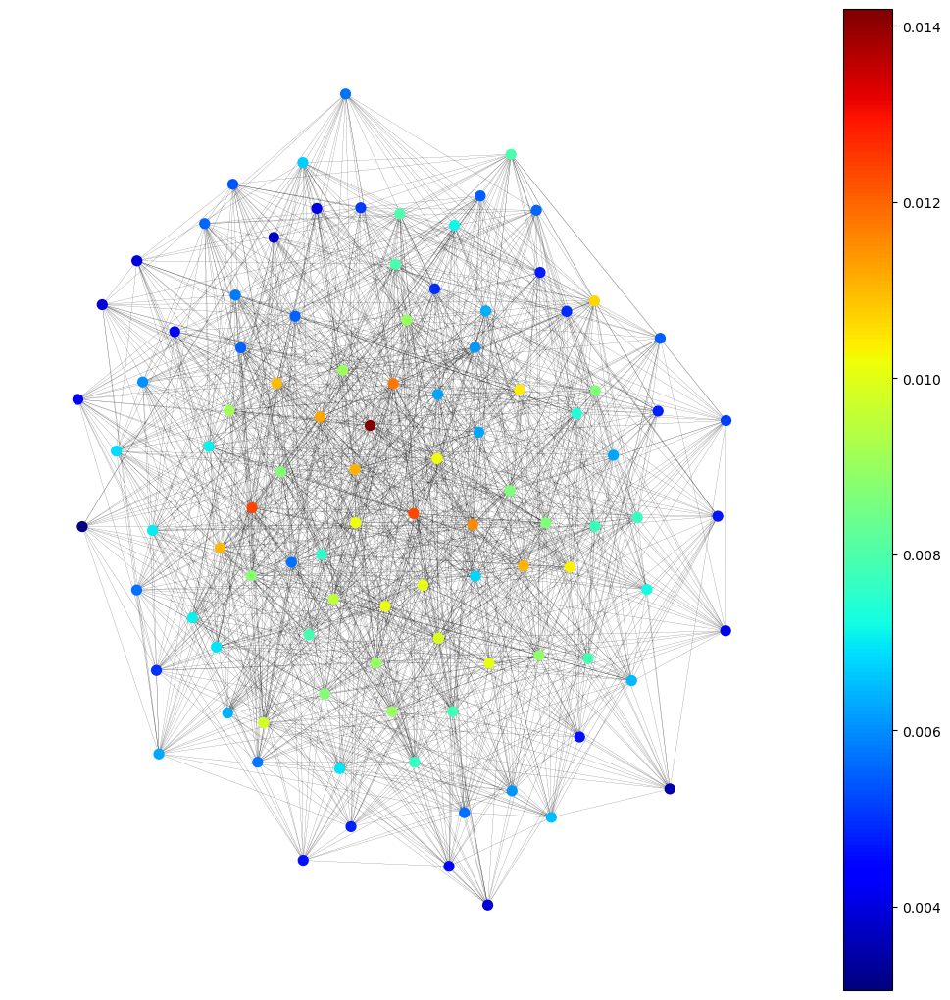

In [413]:
graph_plotter(graph1,bcolor1)

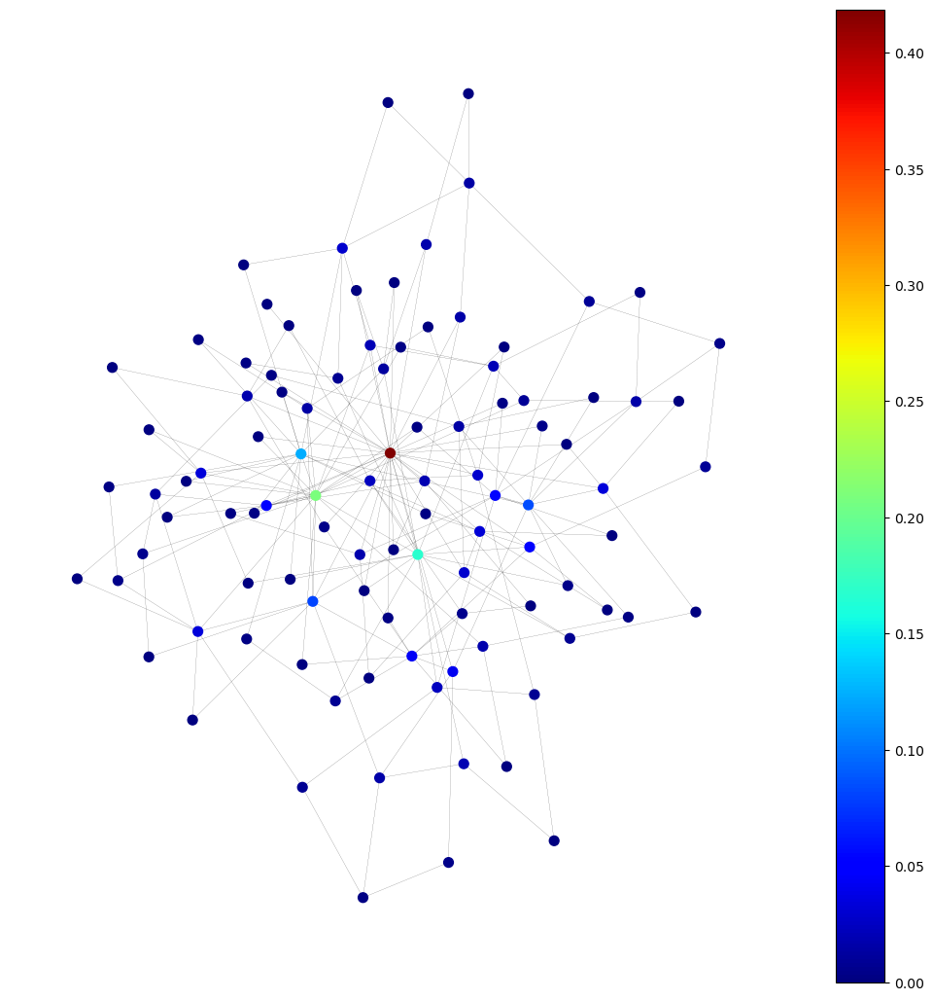

In [414]:
graph_plotter(graph2, bcolor2)

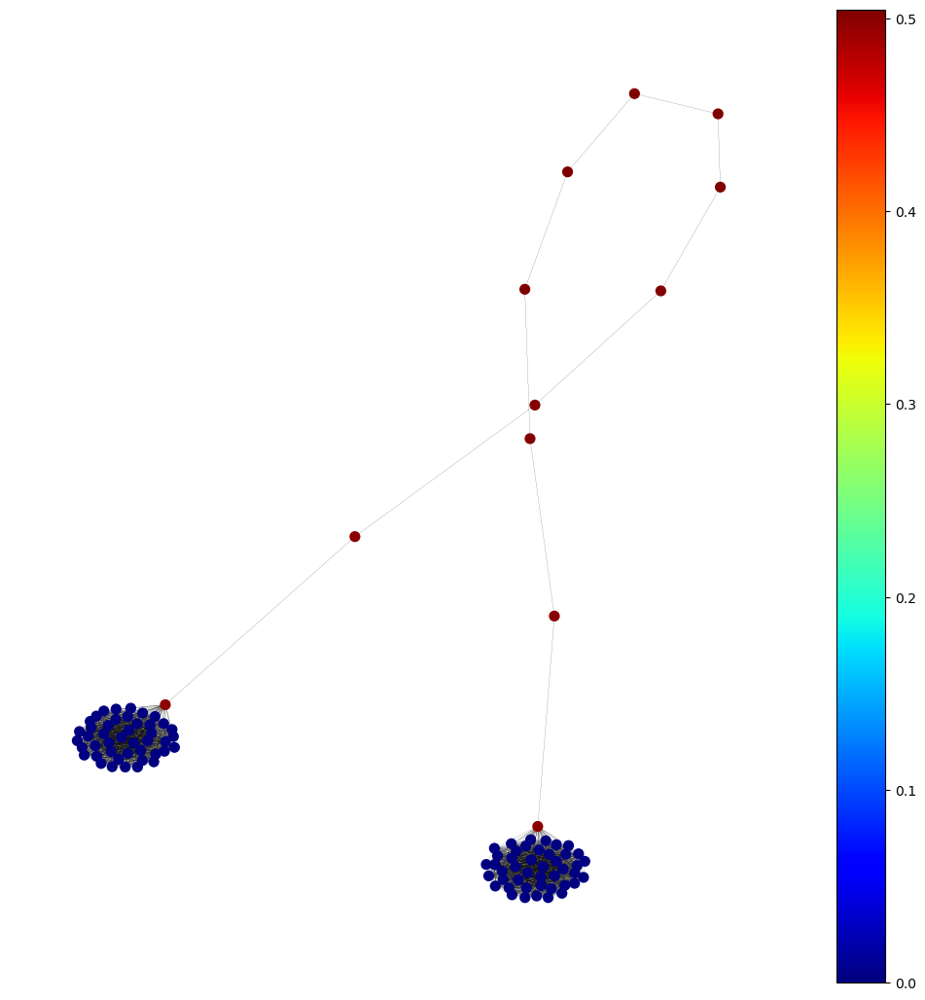

In [415]:
graph_plotter(graph3, bcolor3)

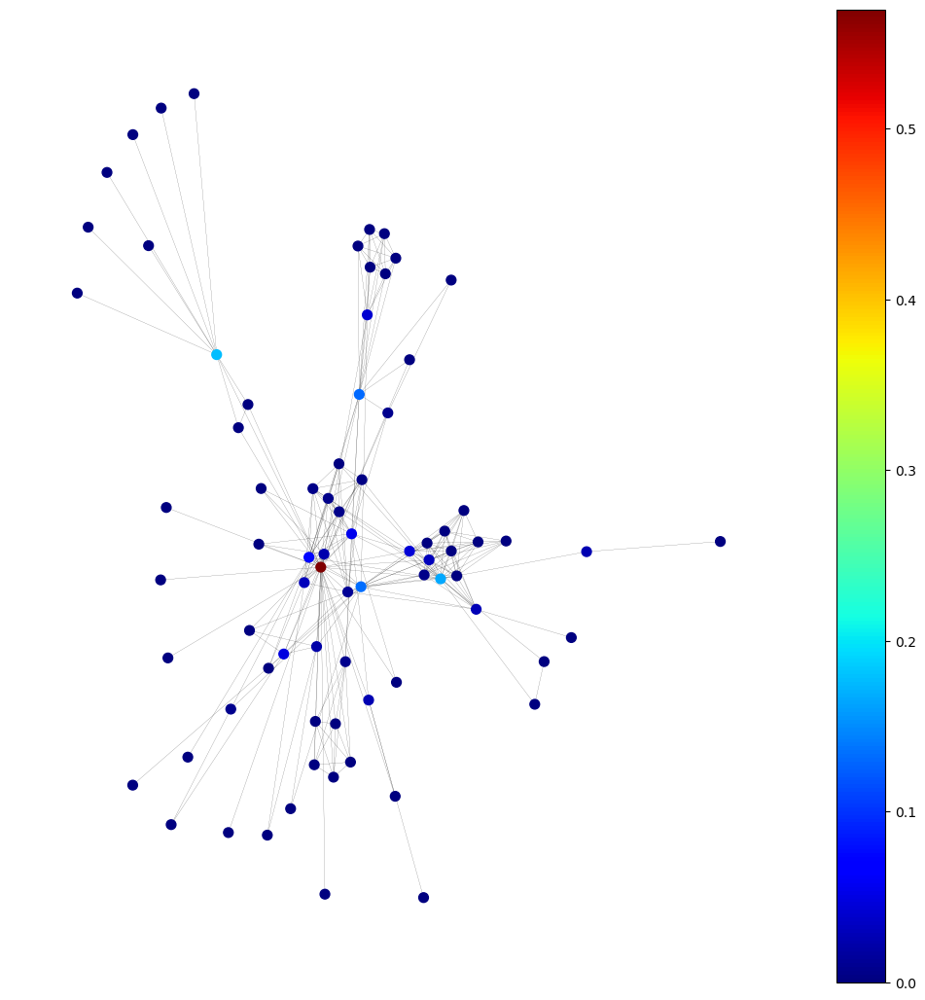

In [416]:
les_plotter(graph4)

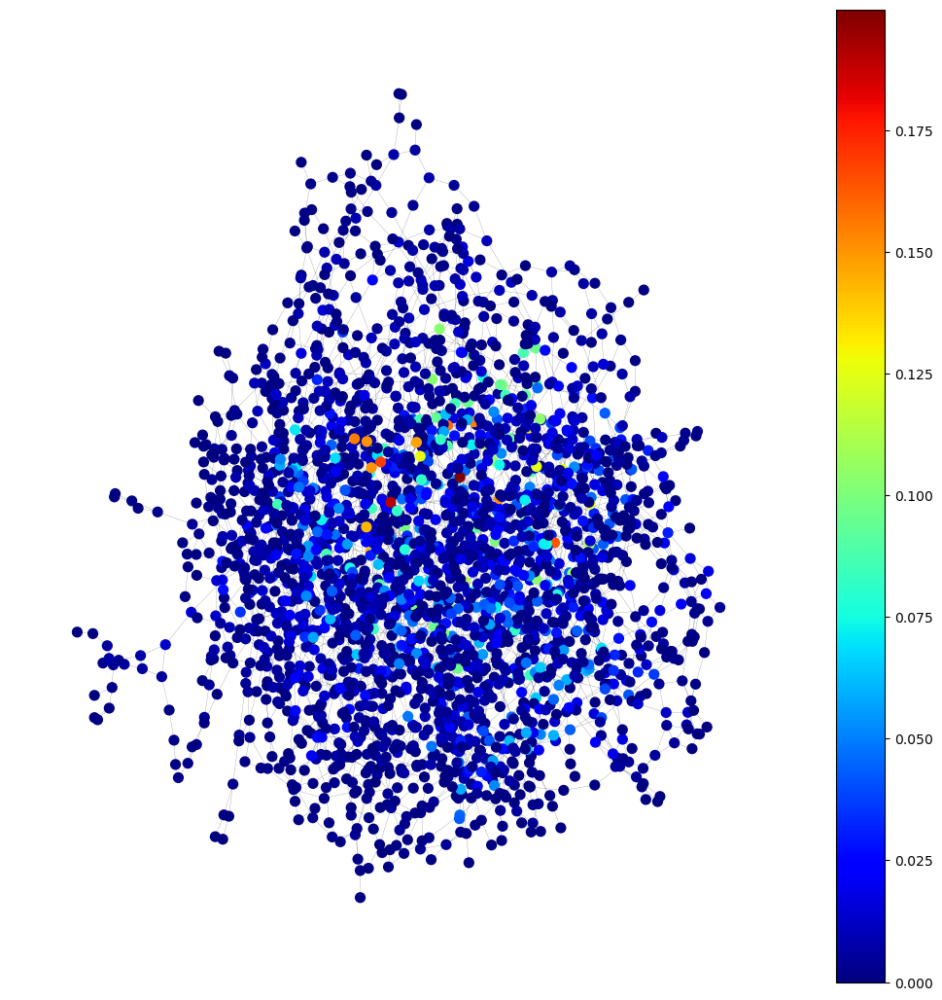

In [418]:
graph_plotter(graph5,bcolor5)

In [ ]:
# for betweeness graphs we can see which hubs have a high volume of
# shortest paths, in these graphs it appears to actually be
# near the center of the graphs, which makes since based on the 
# definition

In [424]:
#) compute closeness
closeness_list1 = nx.closeness_centrality(graph1)
ccolor1 = [closeness_list1[i] for i in range(len(closeness_list1))]
closeness_list2 = nx.closeness_centrality(graph2)
ccolor2 = [closeness_list2[i] for i in range(len(closeness_list2))]
closeness_list3 = nx.closeness_centrality(graph3)
ccolor3 = [closeness_list3[i] for i in range(len(closeness_list3))]
closeness_list4 = nx.closeness_centrality(graph4)

nx.set_node_attributes(graph4,closeness_list4,name='color') 

closeness_list5 = nx.closeness_centrality(graph5)
ccolor5 = [closeness_list5[i] for i in range(len(closeness_list5))]

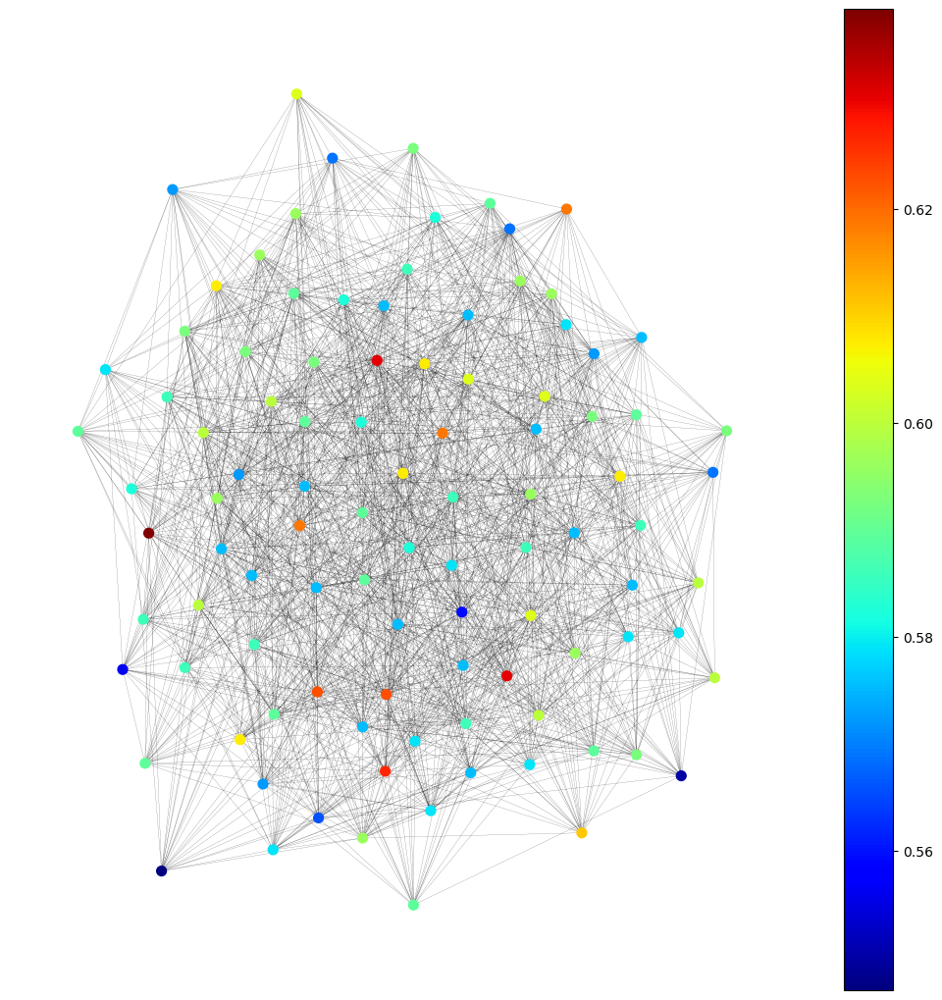

In [420]:
graph_plotter(graph1,ccolor1)

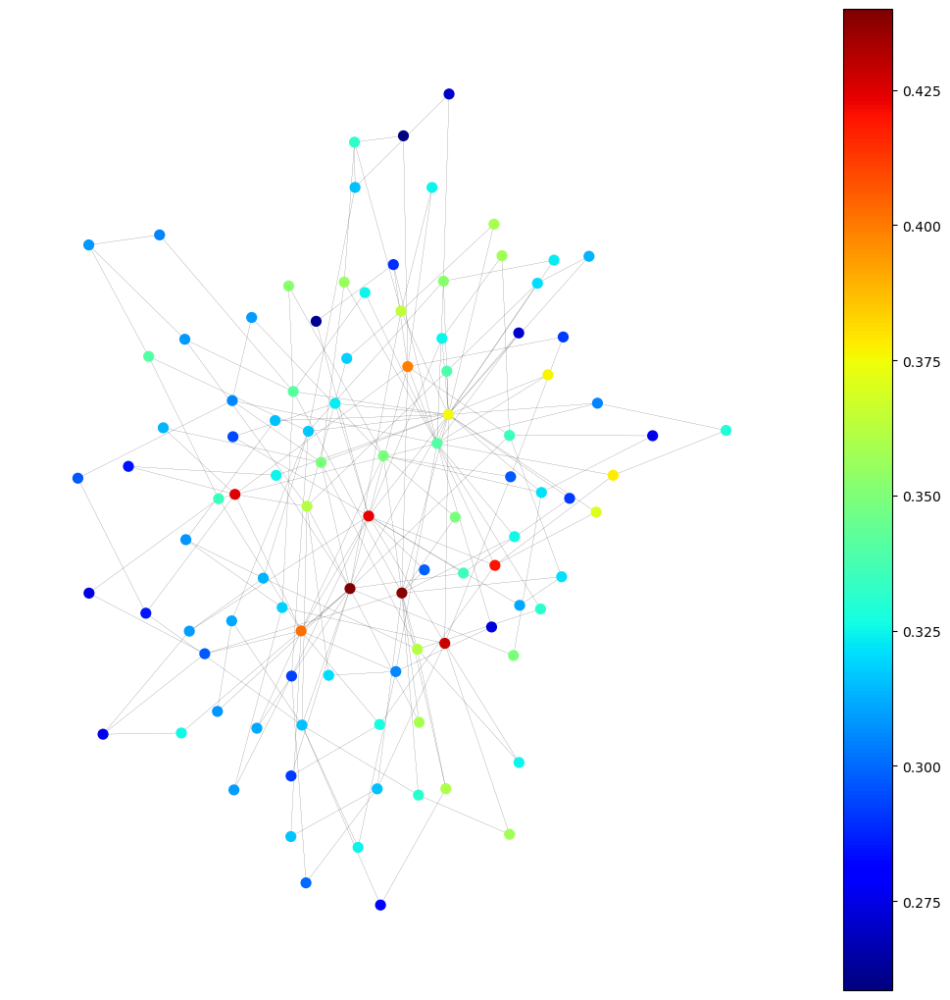

In [421]:
graph_plotter(graph2,ccolor2)

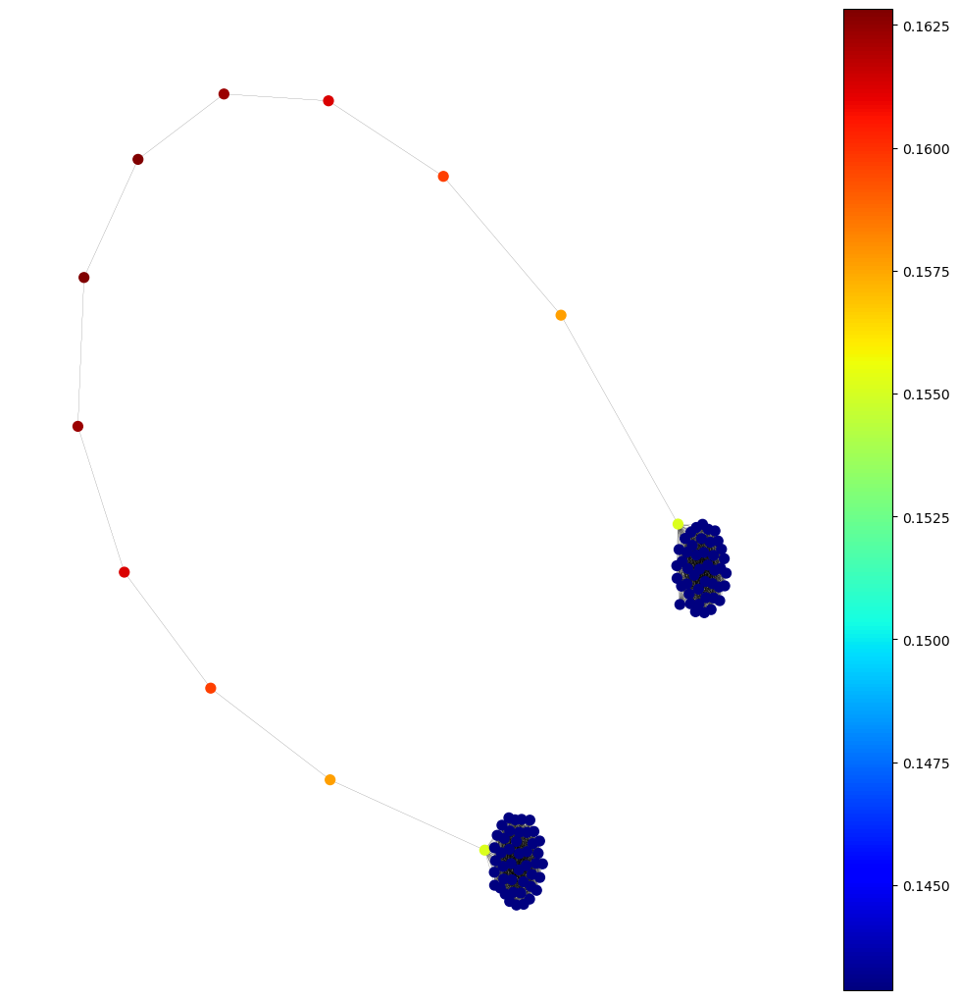

In [422]:
graph_plotter(graph3,ccolor3)

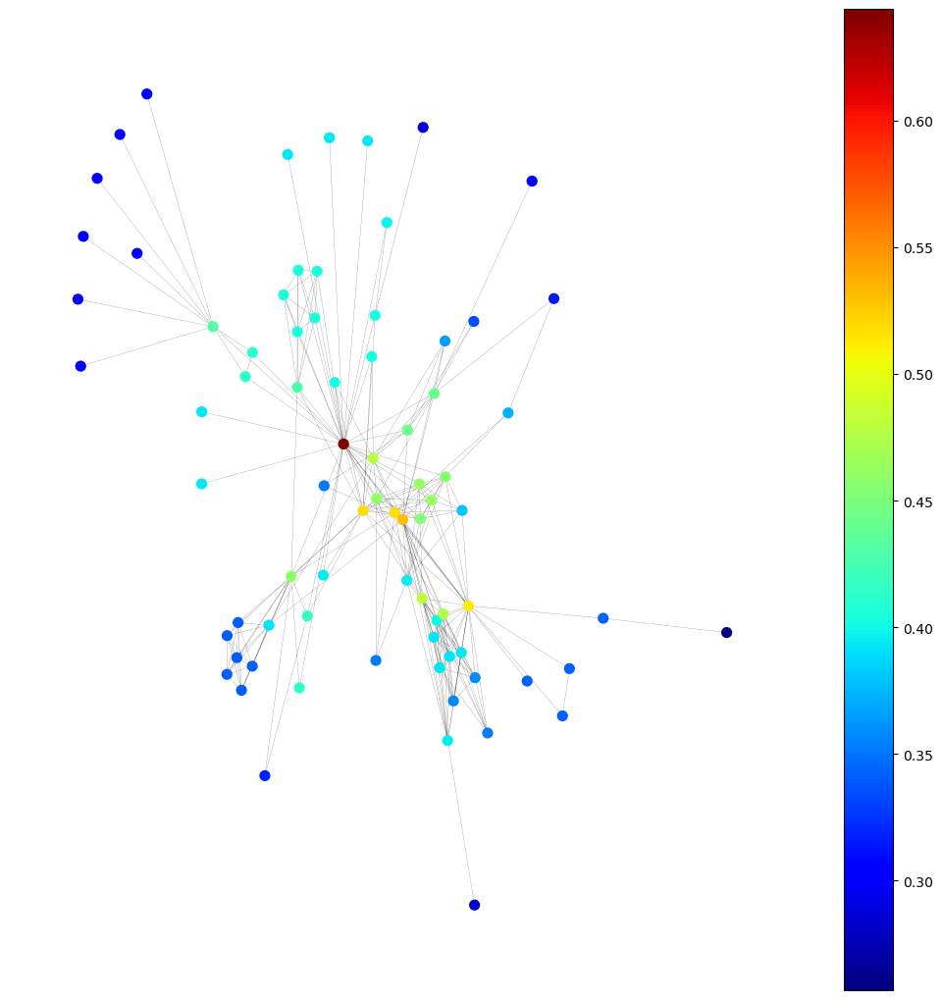

In [425]:
les_plotter(graph4)

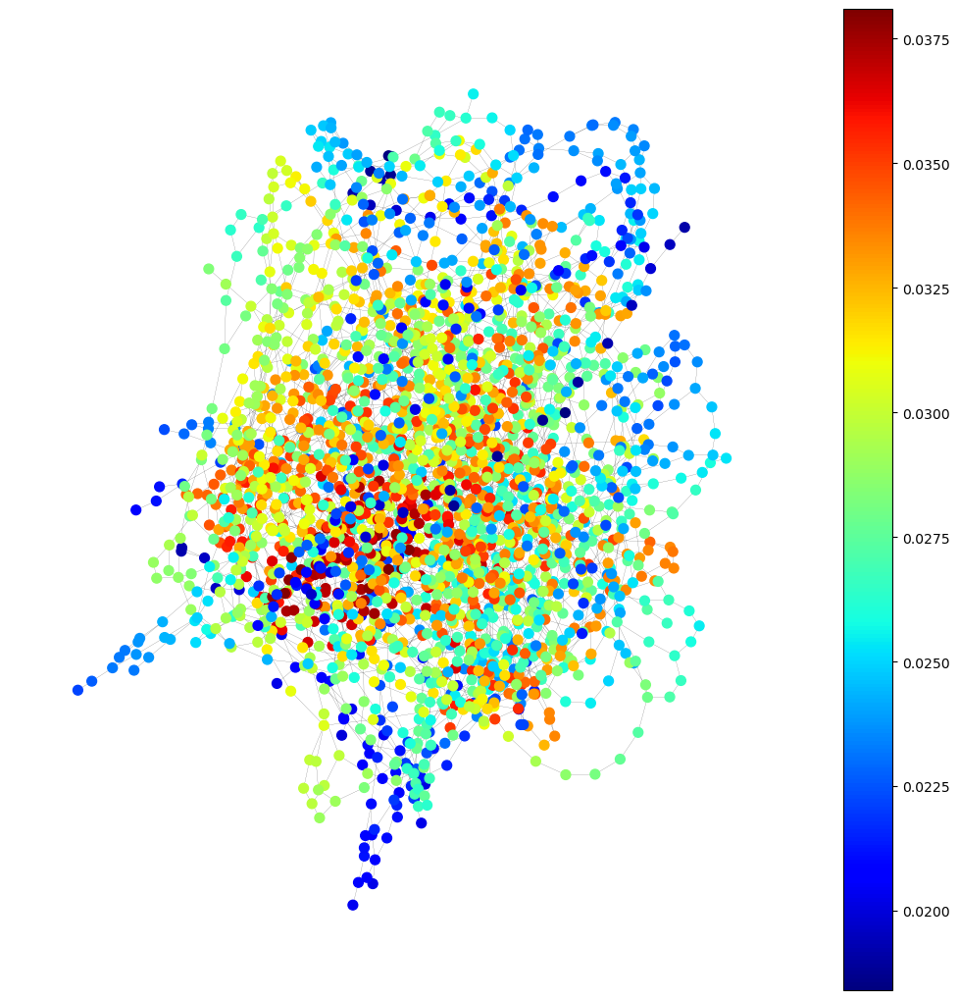

In [426]:
graph_plotter(graph5,ccolor5)

In [ ]:
# closeness measures how close a node is to all other nodes, 
# another centrality measurement, in this case graph 3 shows a 
# good example as the yellowmost on the line connecting the 
# two clusters demonstrates how it acts as the node of minimum steps to
# reach both the left and right clusters, and farther from the 
# middle of the line the color changes as it get pulled farther from 
# the other cluster, increasing distance

In [428]:
#) compute eigenvector
eigenvector_list1 = nx.eigenvector_centrality(graph1)
ecolor1 = [eigenvector_list1[i] for i in range(len(eigenvector_list1))]
eigenvector_list2 = nx.eigenvector_centrality(graph2)
ecolor2 = [eigenvector_list2[i] for i in range(len(eigenvector_list2))]
eigenvector_list3 = nx.eigenvector_centrality(graph3)
ecolor3 = [eigenvector_list3[i] for i in range(len(eigenvector_list3))]
eigenvector_list4 = nx.eigenvector_centrality(graph4)
nx.set_node_attributes(graph4,eigenvector_list4,name='color') 


eigenvector_list5 = nx.eigenvector_centrality_numpy(graph5)
ecolor5 = [eigenvector_list5[i] for i in range(len(eigenvector_list5))]

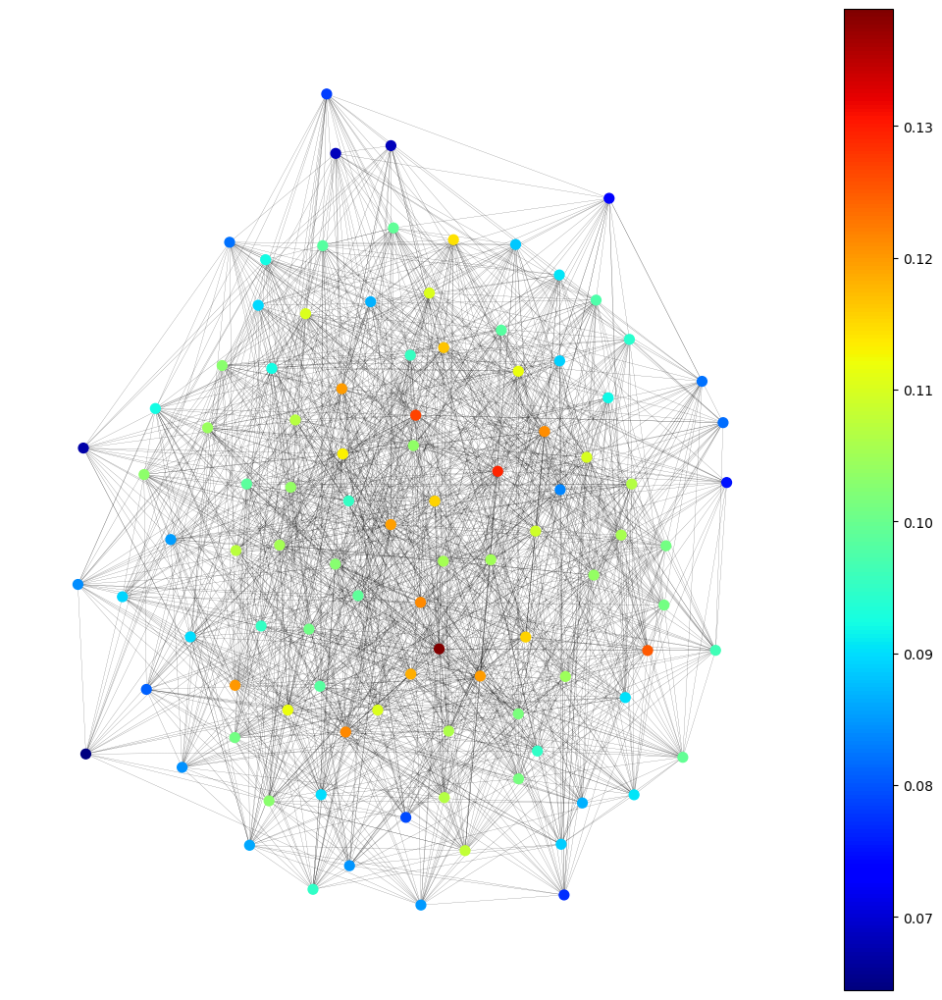

In [429]:
graph_plotter(graph1,ecolor1)

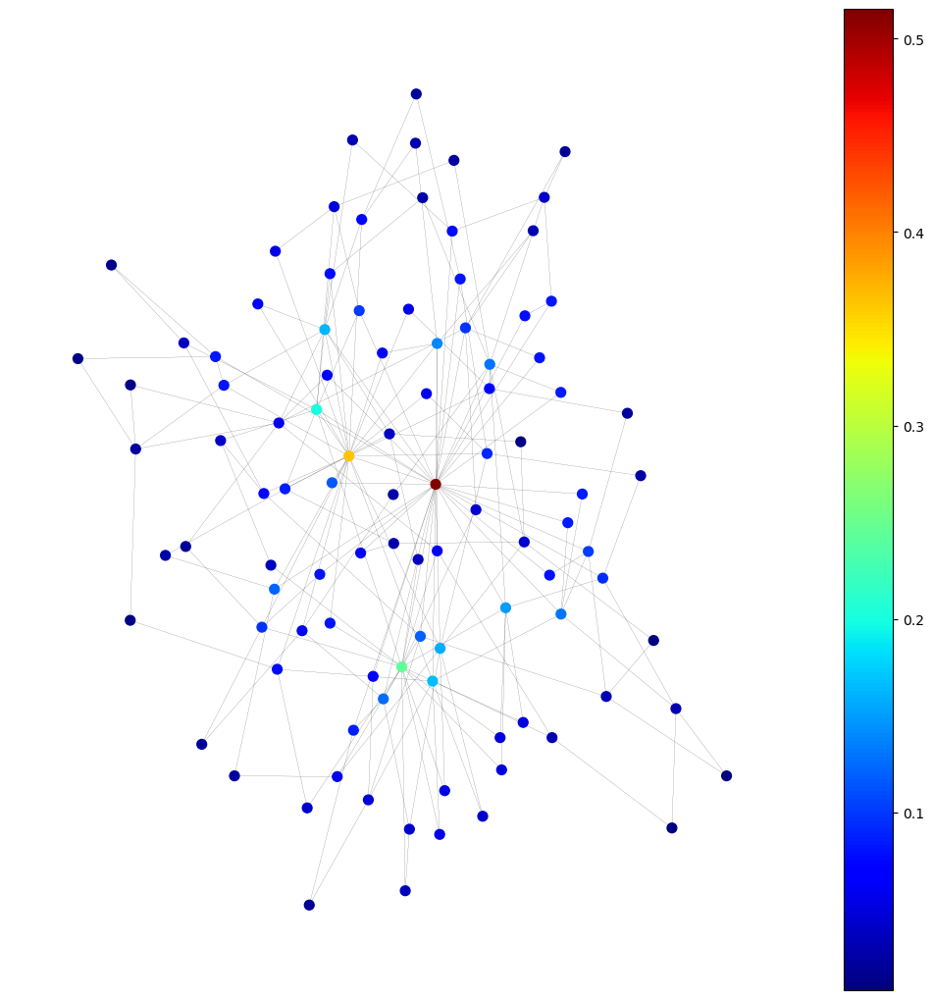

In [430]:
graph_plotter(graph2,ecolor2)

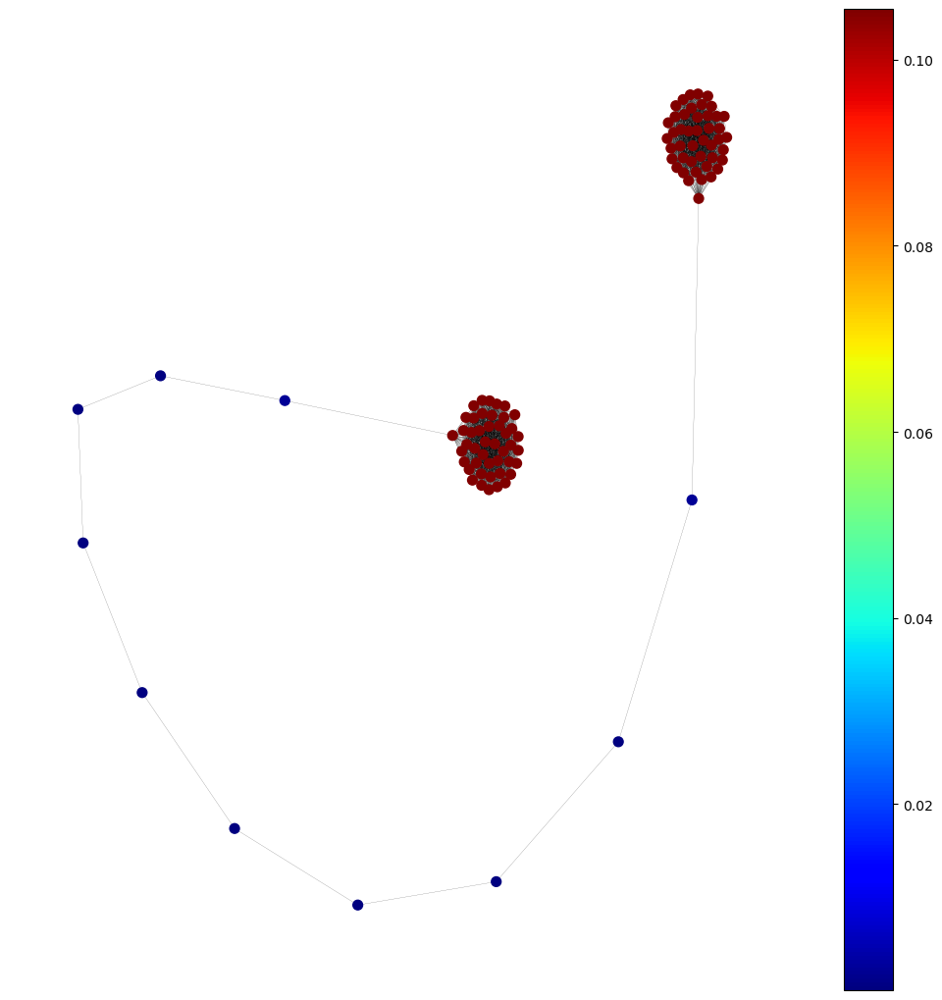

In [431]:
graph_plotter(graph3,ecolor3)

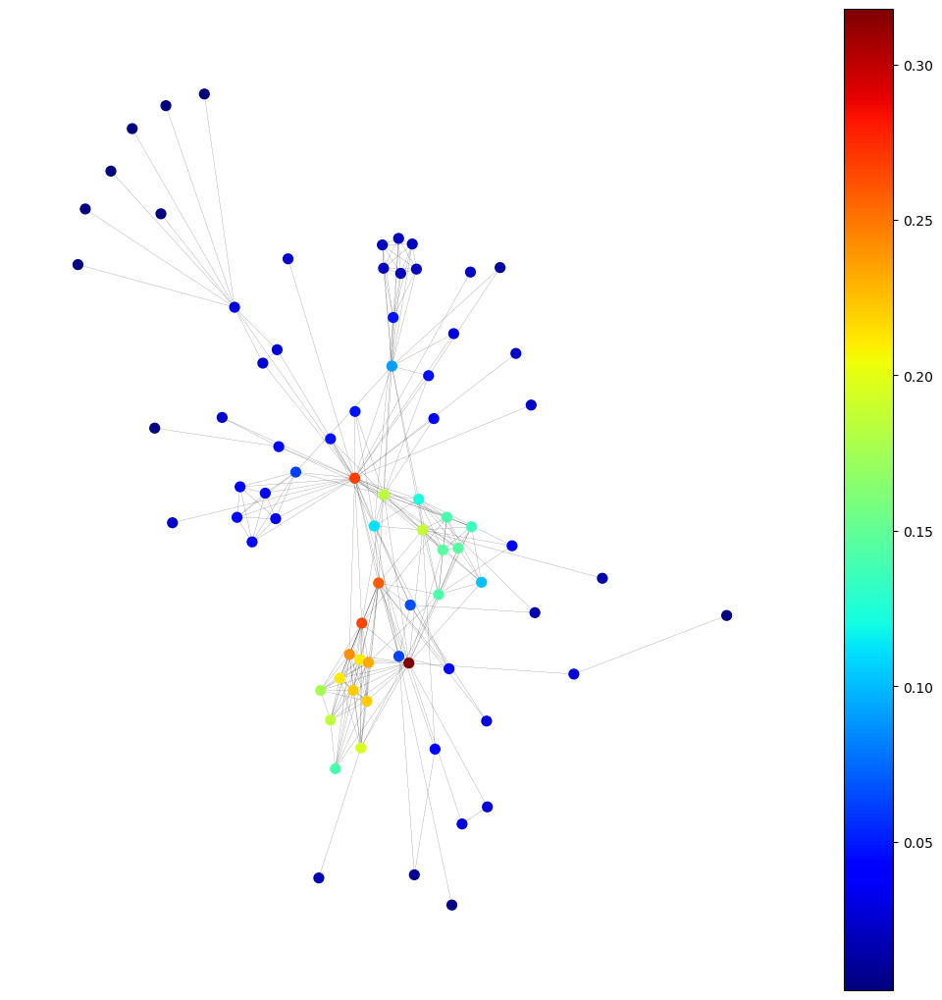

In [432]:
les_plotter(graph4)

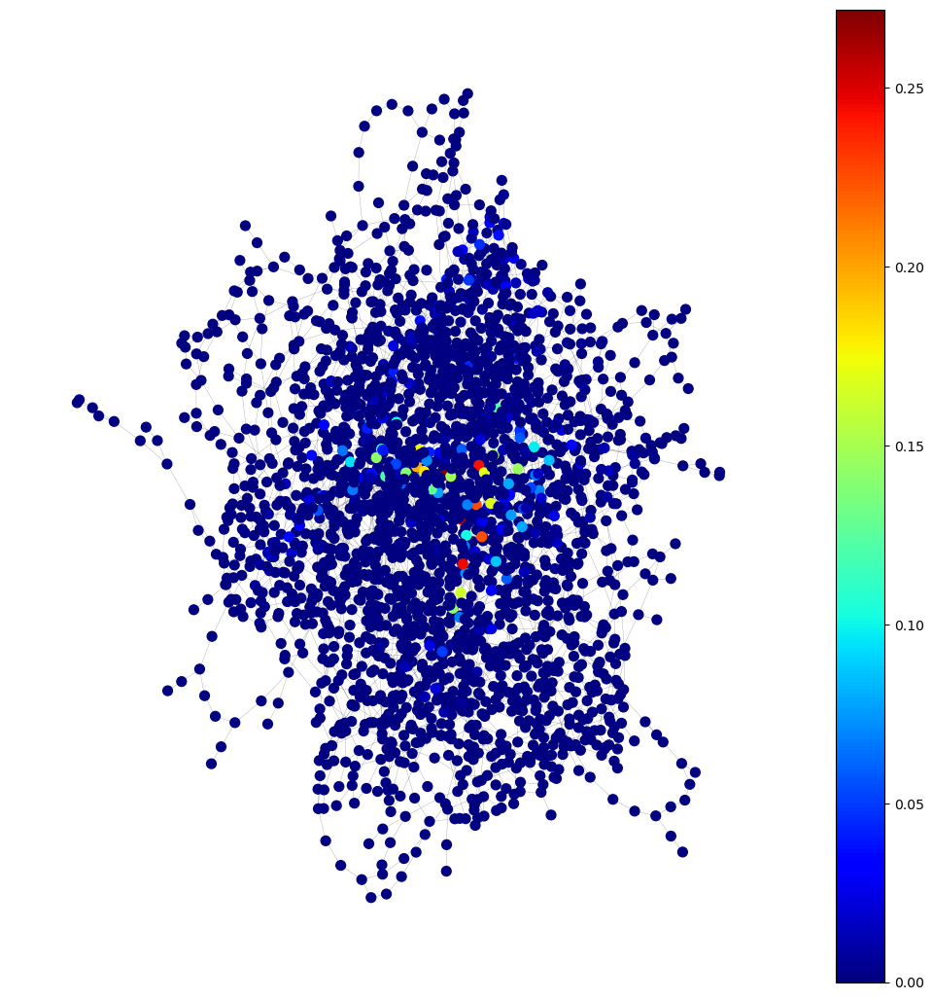

In [433]:
graph_plotter(graph5,ecolor5)

In [ ]:
# eigenvector centrality lets us evaluate centrality by also 
# considering centrality of neighbors so we can identify 
# critial target nodes with a high measure, I think graph5 displays
# this well comparing it to closeness measure where the majority
# of the graph is colored, we have the majority of the graph not 
# colored here except for high measured nodes

In [436]:
#) compute degree centralities
degree_centrality1_list = nx.degree_centrality(graph1)
dcolor1 = [degree_centrality1_list[i] for i in range(len(degree_centrality1_list))]
degree_centrality2_list = nx.degree_centrality(graph2)
dcolor2 = [degree_centrality2_list[i] for i in range(len(degree_centrality2_list))]
degree_centrality3_list = nx.degree_centrality(graph3)
dcolor3 = [degree_centrality3_list[i] for i in range(len(degree_centrality3_list))]
degree_centrality4_list = nx.degree_centrality(graph4)
nx.set_node_attributes(graph4,degree_centrality4_list,name='color') 


degree_centrality5_list = nx.degree_centrality(graph5)
dcolor5 = [degree_centrality5_list[i] for i in range(len(degree_centrality5_list))]


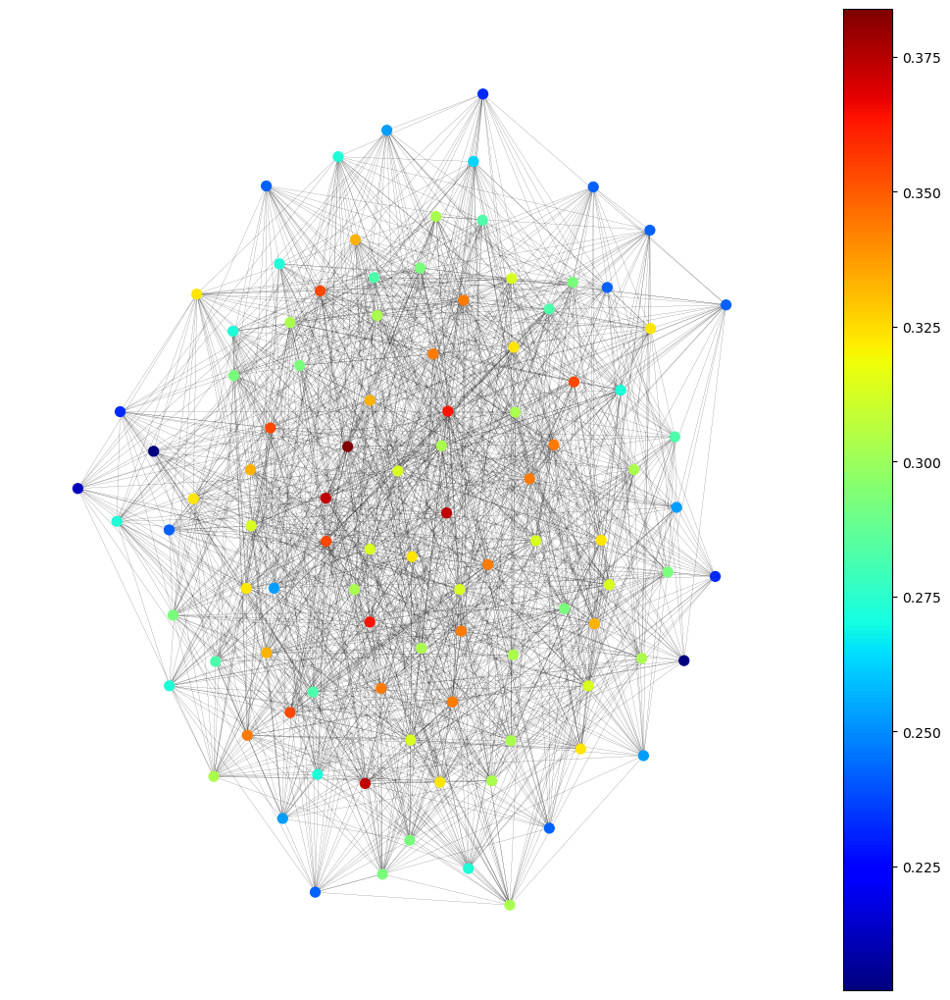

In [437]:
graph_plotter(graph1,dcolor1)

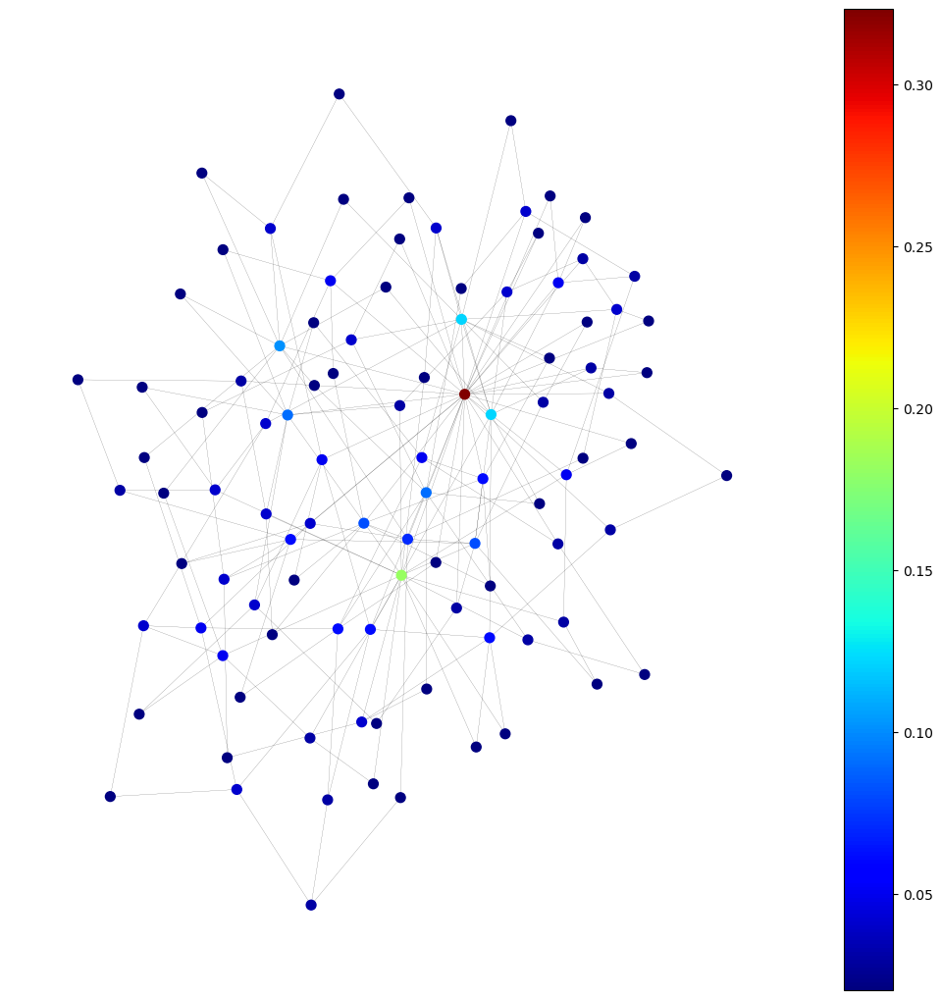

In [438]:
graph_plotter(graph2,dcolor2)

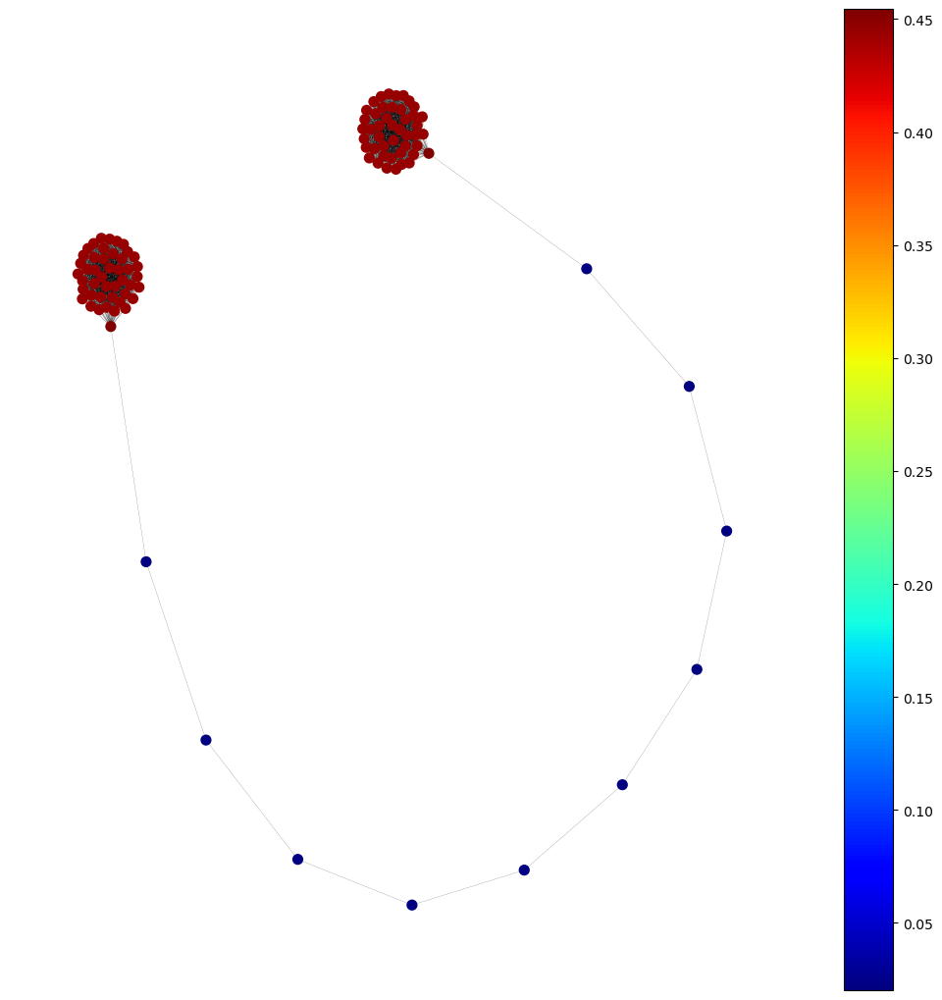

In [439]:
graph_plotter(graph3,dcolor3)

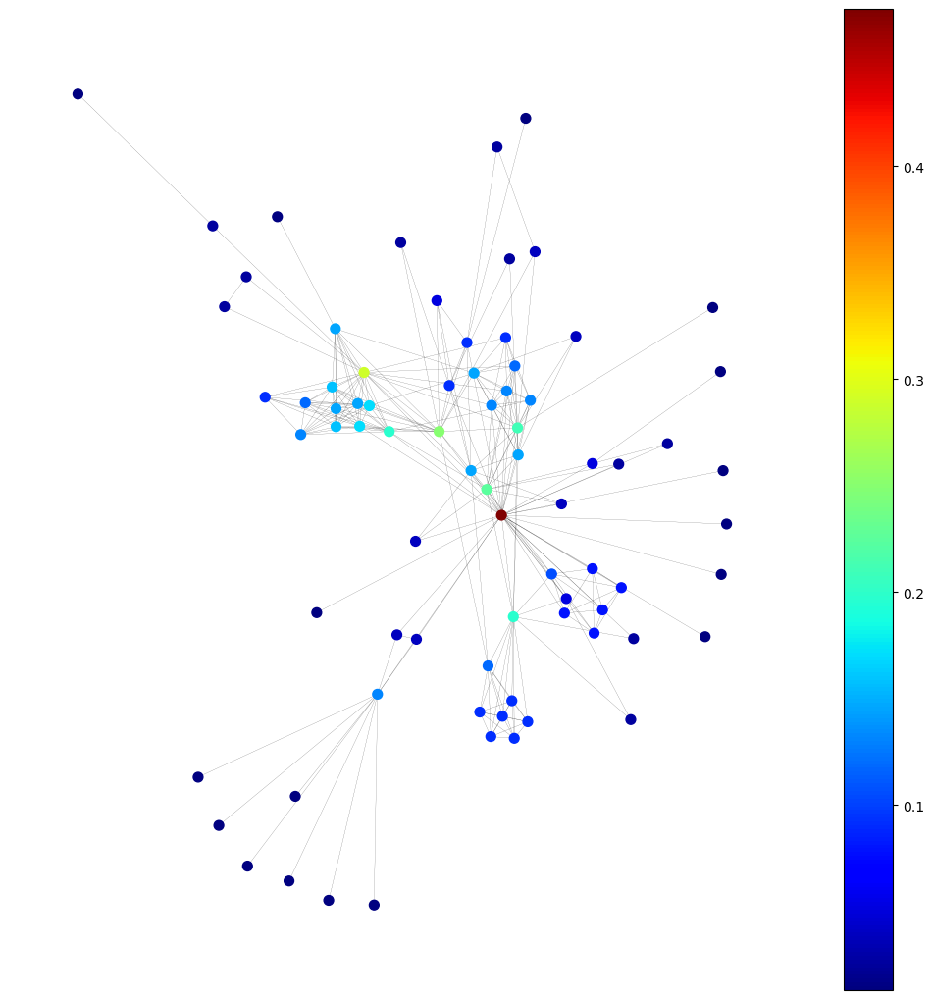

In [440]:
les_plotter(graph4)

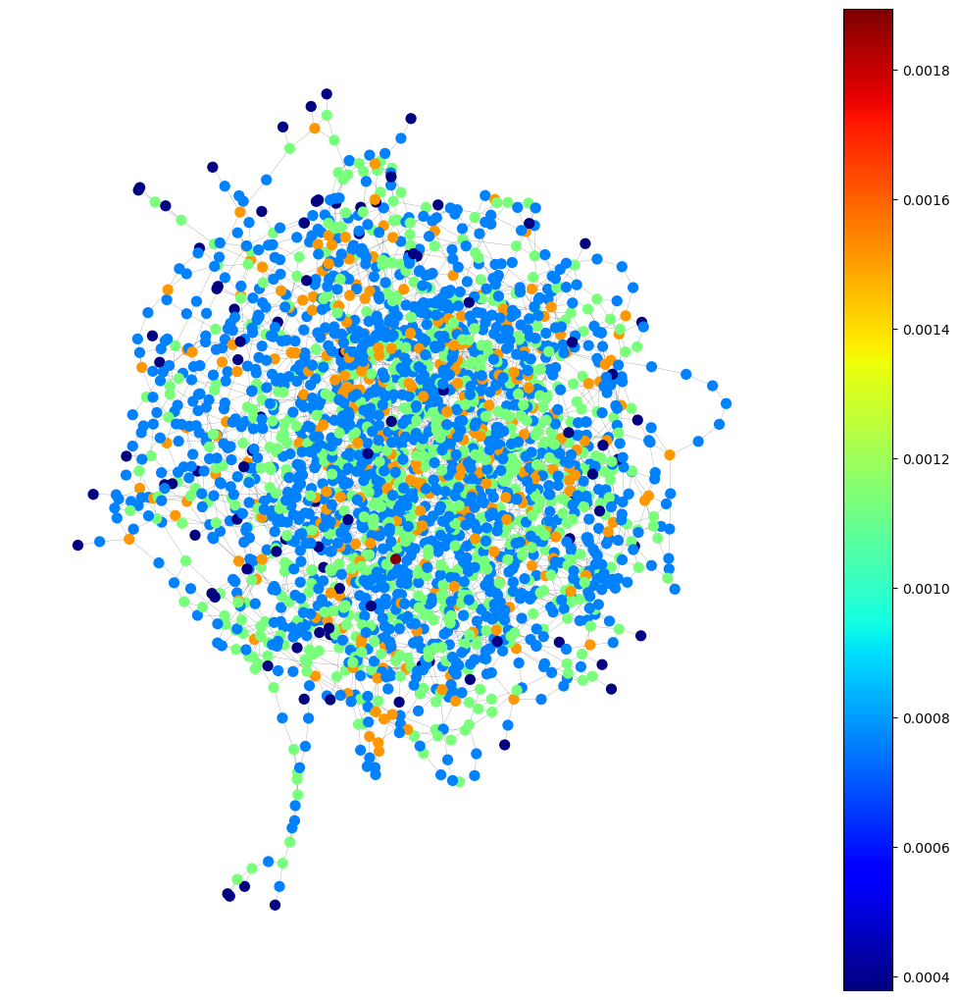

In [441]:
graph_plotter(graph5,dcolor5)

In [ ]:
# for degree measurement the barbell graph displays this best, 
# the clusters on the left and right are colored because they 
# are fully connected and have a high degree compared to 
# nodes in the middle line which have degree of 2

In [ ]:
## question 2) done

In [ ]:
#we can build the sbm with a 100x100 adjacency matrix,
# diagonal sub matrices generated with edge probability p,
# non-diagonal sub matrices generated with edge probability q,
#generate submatrices and then concatenate

In [102]:
np.random.binomial(1,.9, size=25)

array([1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1,
       1, 1, 0])

In [106]:
def generate_sub_matrix(prob,n):
    return np.random.binomial(1,prob, size=n*n).reshape(n,n)

In [126]:
q = generate_sub_matrix(.4,5)
q2 = generate_sub_matrix(1,5)
row_1 = np.concatenate((q,q2),axis=1)



q3 = generate_sub_matrix(.4,5)
q4 = generate_sub_matrix(1,5)
row_2 = np.concatenate((q3,q4),axis=1)


np.concatenate((row_1,row_2))

array([[1, 0, 0, 1, 0, 1, 1, 1, 1, 1],
       [0, 1, 0, 0, 1, 1, 1, 1, 1, 1],
       [0, 0, 1, 1, 0, 1, 1, 1, 1, 1],
       [1, 0, 0, 1, 1, 1, 1, 1, 1, 1],
       [0, 0, 0, 0, 1, 1, 1, 1, 1, 1],
       [1, 0, 0, 0, 1, 1, 1, 1, 1, 1],
       [1, 1, 1, 1, 0, 1, 1, 1, 1, 1],
       [0, 1, 0, 0, 1, 1, 1, 1, 1, 1],
       [1, 0, 0, 0, 1, 1, 1, 1, 1, 1],
       [1, 0, 0, 1, 0, 1, 1, 1, 1, 1]])

In [133]:
def generate_stochastic_block(p,q,n,l):
    
    all_rows = np.array([])
    for n in np.arange(l):
        row = np.array([])
        for p in np.arange(l):
            if n == p:
                row = np.append(row,generate_sub_matrix(p,n))
            else:
                row = np.append(row,generate_sub_matrix(q,n))
        all_rows = np.append(all_rows,(np.concatenate((row[0],row[1],row[2],row[3]),axis = 1))) 
        print(all_rows)
    final_matrix = np.matrix([])
    all_rows = np.concatenate((all_rows[0],all_rows[1],all_rows[2],all_rows[3]), axis = 0)
    return all_rows
            
        

In [ ]:
def generate_stochastic_block(p,q,n,l):
    q_submatrices = np.array([])
    for n in np.arange(4):
        q_submatrices = np.append(q_submatrices)

In [ ]:
# wanted to do a general function but kept getting errors
# with array and matrix dimension errors when appending
# and concatenating

In [140]:
def generate_stochastic_block_hardcode(q,p,l):
    q_ = generate_sub_matrix(q,l)
    q2_ = generate_sub_matrix(p,l)
    q3_ = generate_sub_matrix(p,l)
    q4_ = generate_sub_matrix(p,l)
    row_1 = np.concatenate((q_,q2_,q3_,q4_),axis=1)



    q5_ = generate_sub_matrix(p,l)
    q6_ = generate_sub_matrix(q,l)
    q7_ = generate_sub_matrix(p,l)
    q8_ = generate_sub_matrix(p,l)
    row_2 = np.concatenate((q5_,q6_,q7_,q8_),axis=1)
    
    q9_ = generate_sub_matrix(p,l)
    q10_ = generate_sub_matrix(p,l)
    q11_ = generate_sub_matrix(q,l)
    q12_ = generate_sub_matrix(p,l)
    row_3 = np.concatenate((q9_,q10_,q11_,q12_),axis=1)
    
    q13_ = generate_sub_matrix(p,l)
    q14_ = generate_sub_matrix(p,l)
    q15_ = generate_sub_matrix(p,l)
    q16_ = generate_sub_matrix(q,l)
    row_4 = np.concatenate((q13_,q14_,q15_,q16_),axis=1)



    return np.concatenate((row_1,row_2,row_3,row_4), axis = 0)

In [165]:
# create color map 
color_map = []
for node in np.arange(100):
    if node < 25:
        color_map.append('blue')
    elif (node >=25) & (node < 50): 
        color_map.append('green')   
    elif (node >=50) & (node < 75): 
        color_map.append('yellow') 
    elif node >= 75: 
        color_map.append('red') 



In [217]:
color_map

['blue',
 'blue',
 'blue',
 'blue',
 'blue',
 'blue',
 'blue',
 'blue',
 'blue',
 'blue',
 'blue',
 'blue',
 'blue',
 'blue',
 'blue',
 'blue',
 'blue',
 'blue',
 'blue',
 'blue',
 'blue',
 'blue',
 'blue',
 'blue',
 'blue',
 'green',
 'green',
 'green',
 'green',
 'green',
 'green',
 'green',
 'green',
 'green',
 'green',
 'green',
 'green',
 'green',
 'green',
 'green',
 'green',
 'green',
 'green',
 'green',
 'green',
 'green',
 'green',
 'green',
 'green',
 'green',
 'yellow',
 'yellow',
 'yellow',
 'yellow',
 'yellow',
 'yellow',
 'yellow',
 'yellow',
 'yellow',
 'yellow',
 'yellow',
 'yellow',
 'yellow',
 'yellow',
 'yellow',
 'yellow',
 'yellow',
 'yellow',
 'yellow',
 'yellow',
 'yellow',
 'yellow',
 'yellow',
 'yellow',
 'yellow',
 'red',
 'red',
 'red',
 'red',
 'red',
 'red',
 'red',
 'red',
 'red',
 'red',
 'red',
 'red',
 'red',
 'red',
 'red',
 'red',
 'red',
 'red',
 'red',
 'red',
 'red',
 'red',
 'red',
 'red',
 'red']

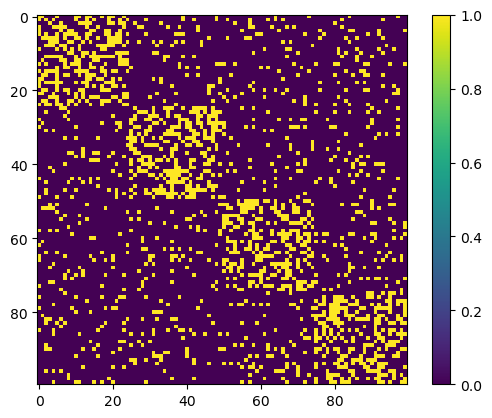

In [232]:
l = generate_stochastic_block_hardcode(.4,.1,25)
l.shape

plt.imshow(l)
plt.colorbar()
plt.show()

In [221]:
sbm_graph = nx.from_numpy_array(l)
sbm_graph.nodes

NodeView((0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99))

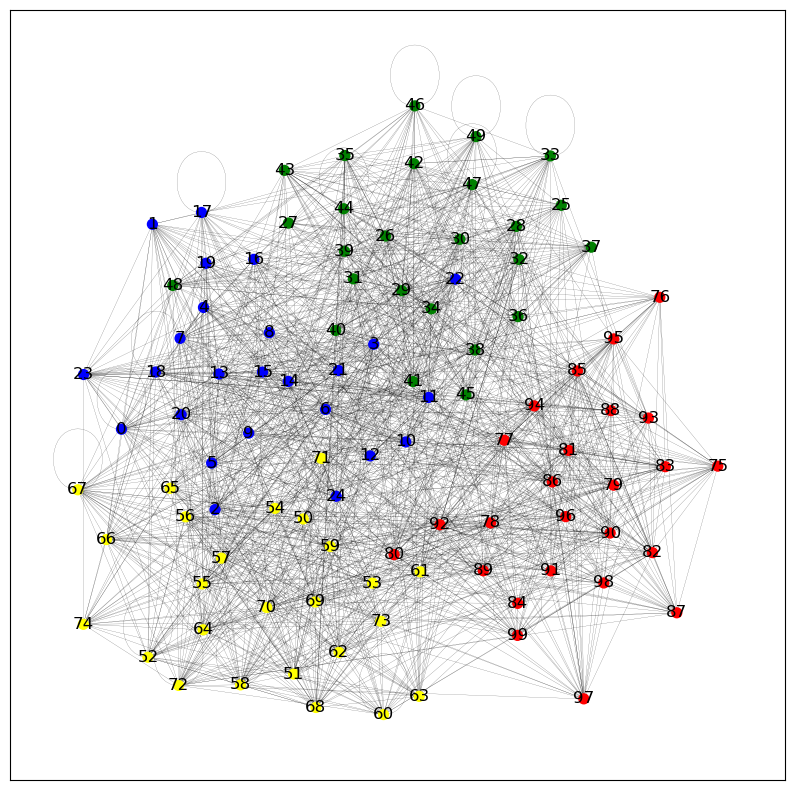

In [233]:
plt.figure(figsize=(10, 10))
sbm_graph = nx.from_numpy_array(l)
#nx.draw(sbm_graph, node_color=color_map, with_labels=True)

pos1=nx.spring_layout(sbm_graph,scale=5) #default to scale=1

nx.draw_networkx(sbm_graph,node_color=color_map,pos = pos, node_size = 50, width = .1)
plt.show()

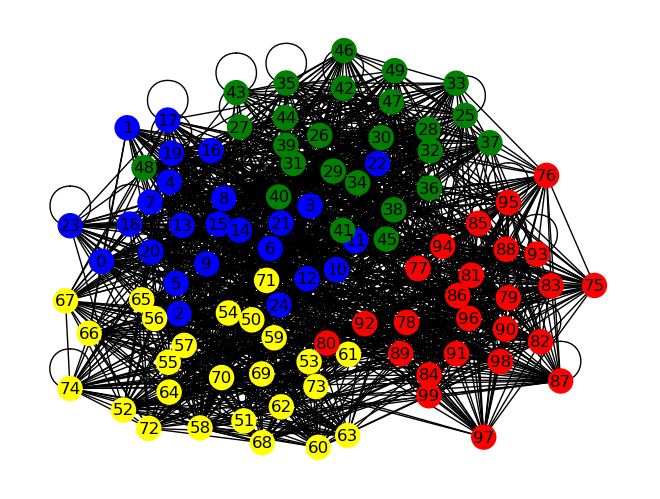

In [167]:
sbm_graph = nx.from_numpy_array(l)
#nx.draw(sbm_graph, node_color=color_map, with_labels=True)

pos1=nx.spring_layout(sbm_graph,scale=2) #default to scale=1

nx.draw(sbm_graph,node_color=color_map, with_labels=True,pos = pos)
plt.show()

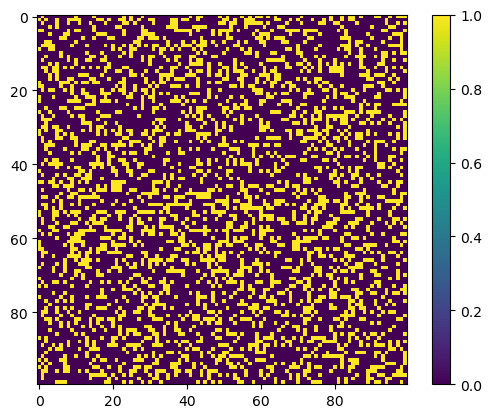

In [243]:
l = generate_stochastic_block_hardcode(.3,.3,25)
l.shape

plt.imshow(l)
plt.colorbar()
plt.show()

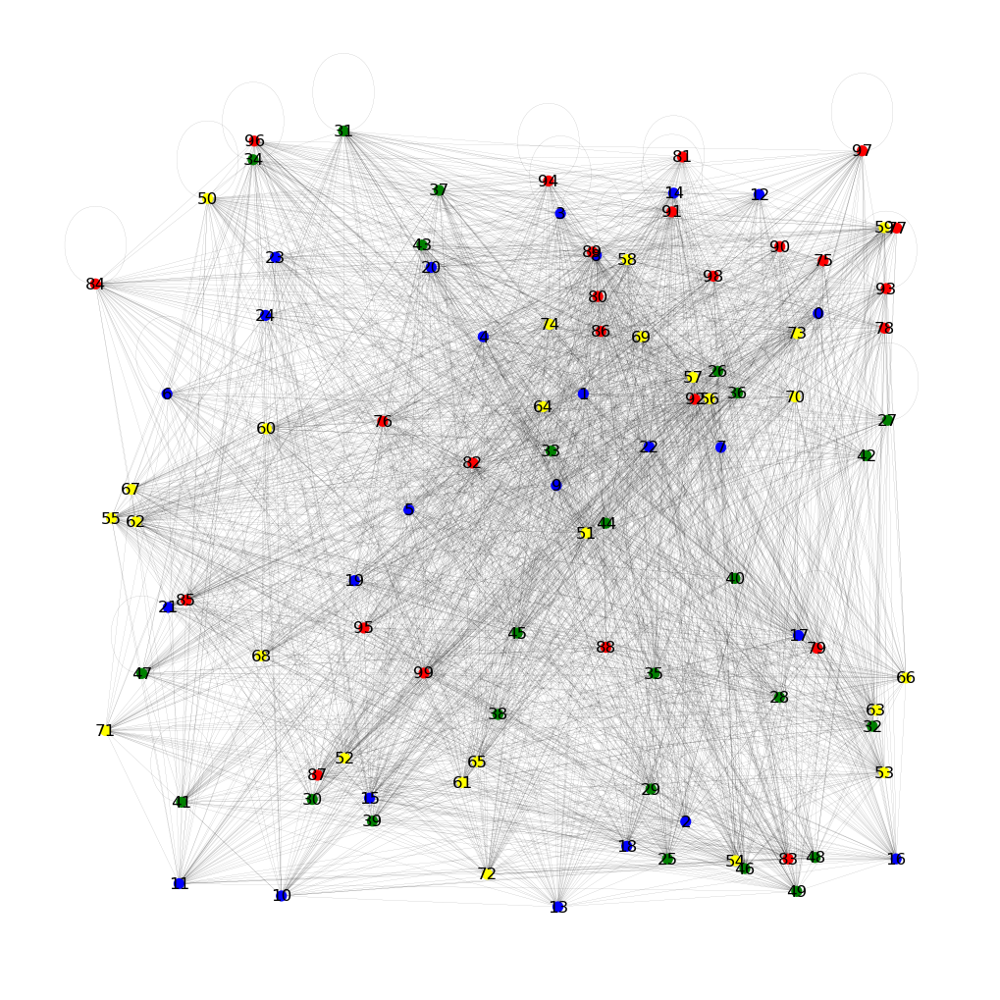

In [244]:
plt.figure(figsize=(10, 10))
sbm_graph = nx.from_numpy_array(l)
#nx.draw(sbm_graph, node_color=color_map, with_labels=True)

pos1=nx.spring_layout(sbm_graph,scale=3) #default to scale=1

nx.draw_random(sbm_graph,node_color=color_map, with_labels=True, node_size = 50, width = .05)
plt.show()

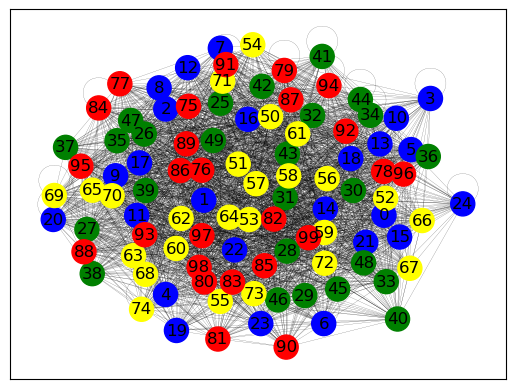

In [245]:
sbm_graph = nx.from_numpy_array(l)
#nx.draw(sbm_graph, node_color=color_map, with_labels=True)

#pos1=nx.circular_layout(sbm_graph,scale=20) #default to scale=1

nx.draw_networkx(sbm_graph,node_color=color_map, with_labels=True, width = 0.1)
plt.show()

In [ ]:
# this is an erdo-renyi simple random graph model

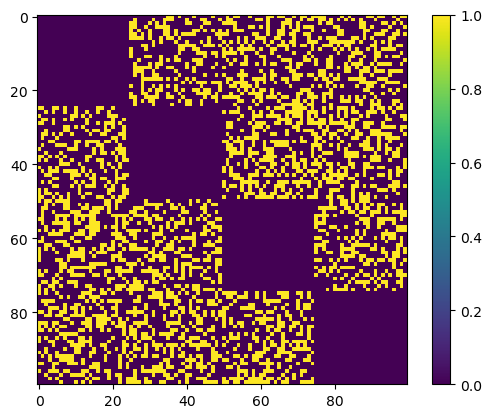

In [246]:
l = generate_stochastic_block_hardcode(.0,.4,25)
l.shape

plt.imshow(l)
plt.colorbar()
plt.show()

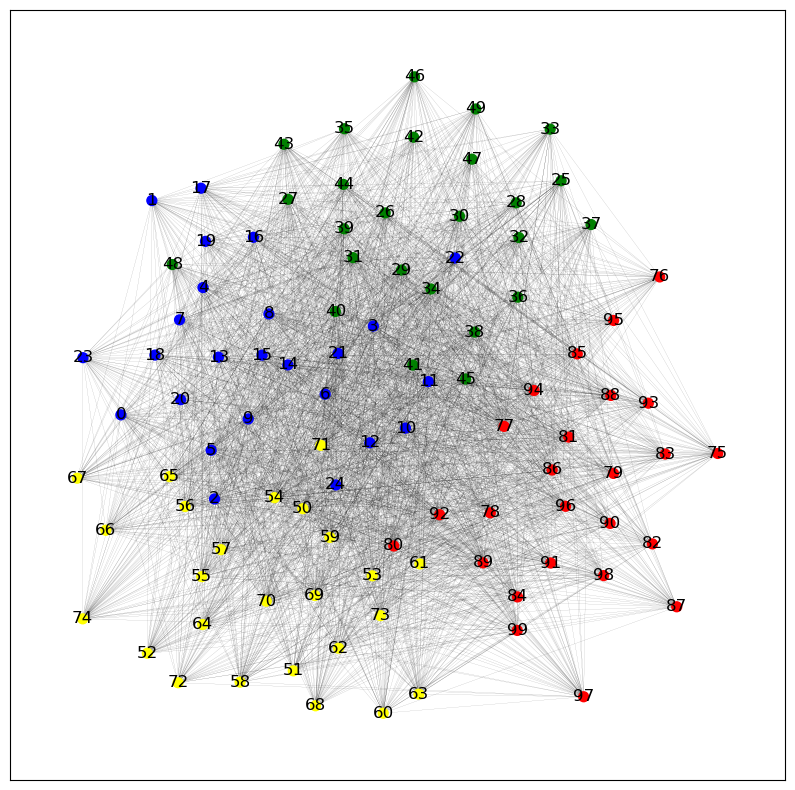

In [247]:
plt.figure(figsize=(10, 10))
sbm_graph = nx.from_numpy_array(l)
#nx.draw(sbm_graph, node_color=color_map, with_labels=True)

pos1=nx.circular_layout(sbm_graph,scale=5) #default to scale=1

nx.draw_networkx(sbm_graph,node_color=color_map,pos = pos, with_labels=True, node_size = 50, width = .05)
plt.show()

In [ ]:
l = generate_stochastic_block_hardcode(.4,.1,25)
l.shape

plt.imshow(l)
plt.colorbar()
plt.show()

In [ ]:
# I was thinking bipartite graph but there are 4 communities
# so it's a multipartite graph

In [481]:
?nx.relaxed_caveman_graph

In [482]:
## question 3)


# generate relaxed caveman graphs with respective p's 
c1 = nx.relaxed_caveman_graph(l = 4, k = 25, p = 0.1)
c2 = nx.relaxed_caveman_graph(l = 4, k = 25, p = 0.25)
c3 = nx.relaxed_caveman_graph(l = 4, k = 25, p = 0.5)


In [489]:
def plot_caveman(graph):
    plt.figure(1,figsize=(10,10))
    nx.draw_random(T,with_labels=True,node_color = color_map,node_size=50,width=0.2)

In [ ]:
#graphs pre clustering

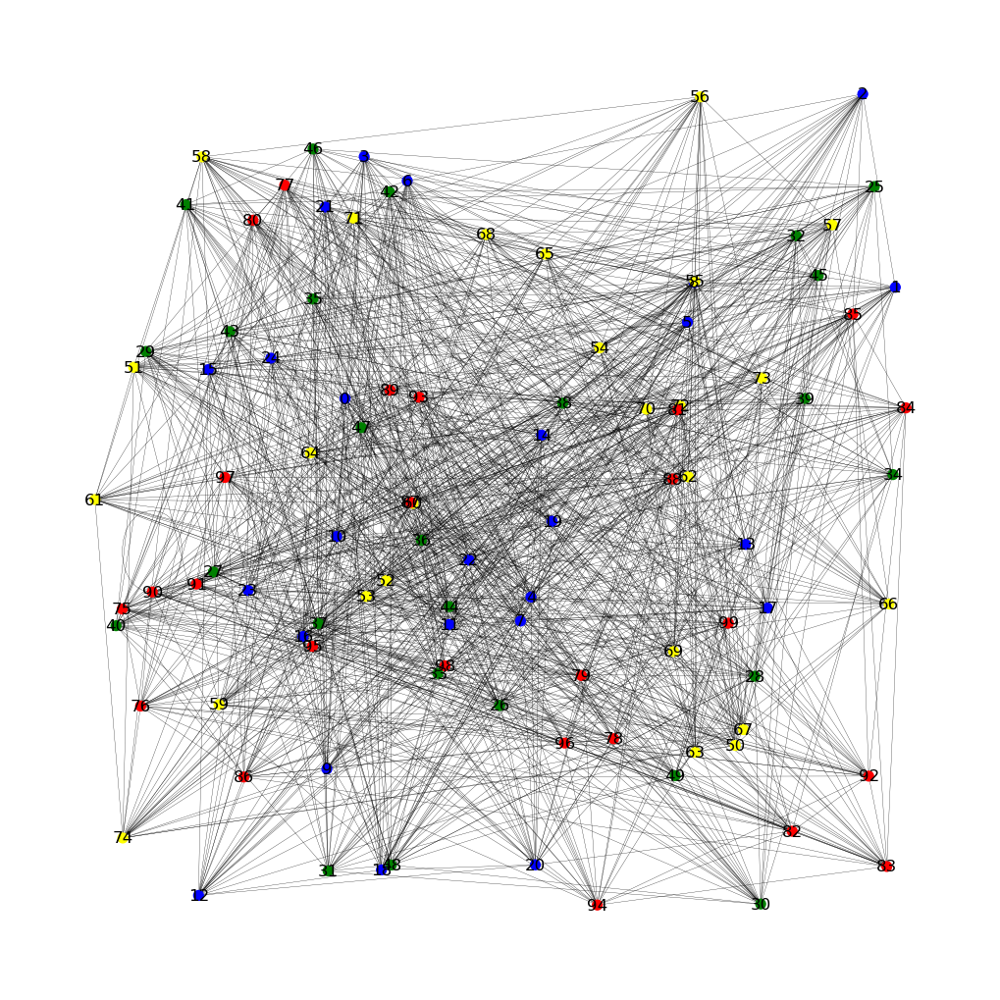

In [490]:
plot_caveman(c1)

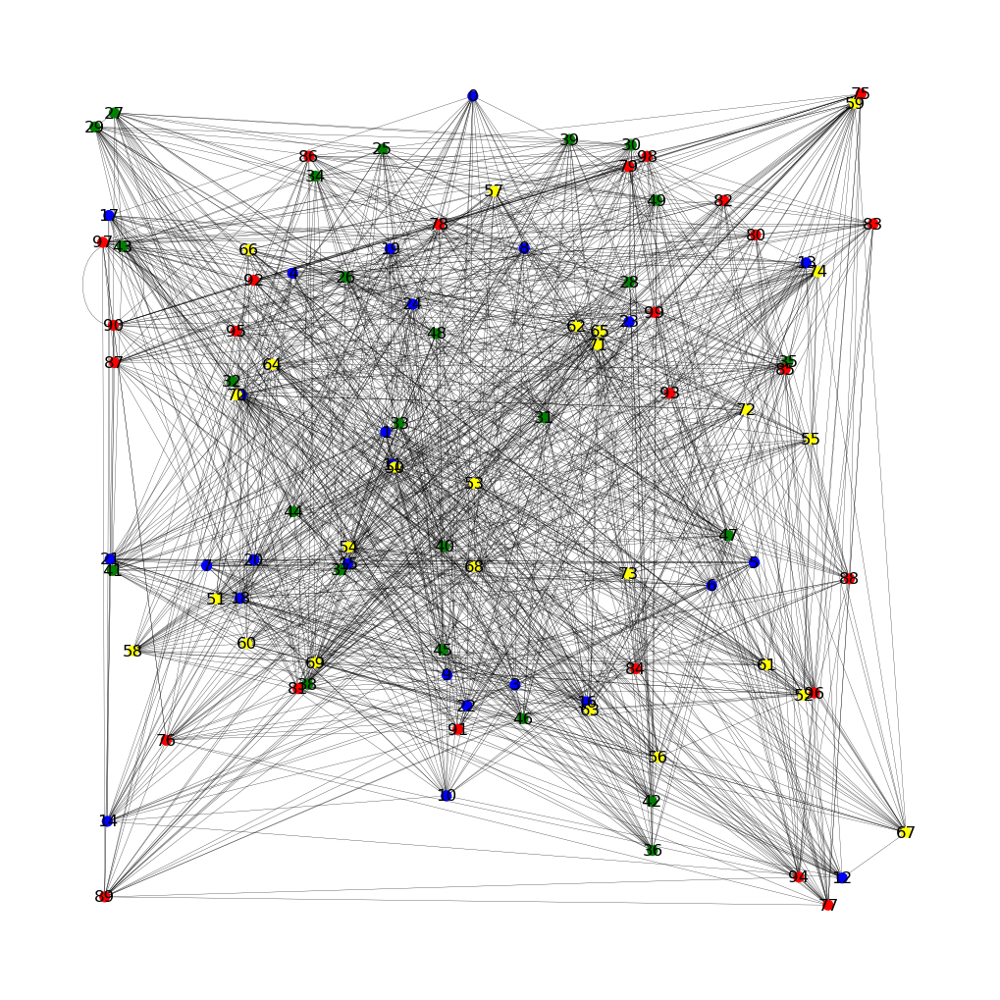

In [491]:
plot_caveman(c2)

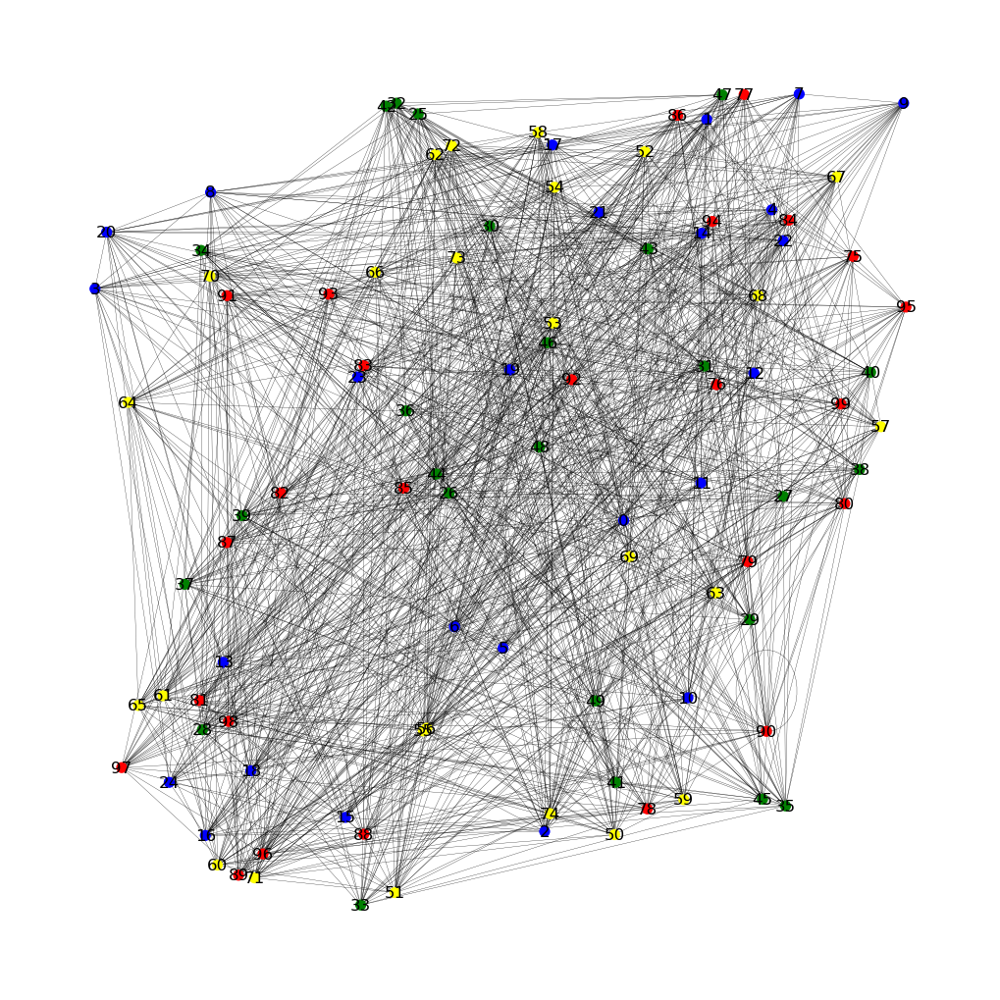

In [492]:
plot_caveman(c3)

In [ ]:
# they all look pretty similar?

In [493]:
#apply Louvain's 
louvain1 = nx.community.louvain_communities(c1)
louvain2 = nx.community.louvain_communities(c2)
louvain3 = nx.community.louvain_communities(c3)


In [494]:
def plotter(graph):
    plt.figure(1,figsize=(10,10))
    nx.draw(T,with_labels=True,node_color = color_map,node_size=50,width=0.2)

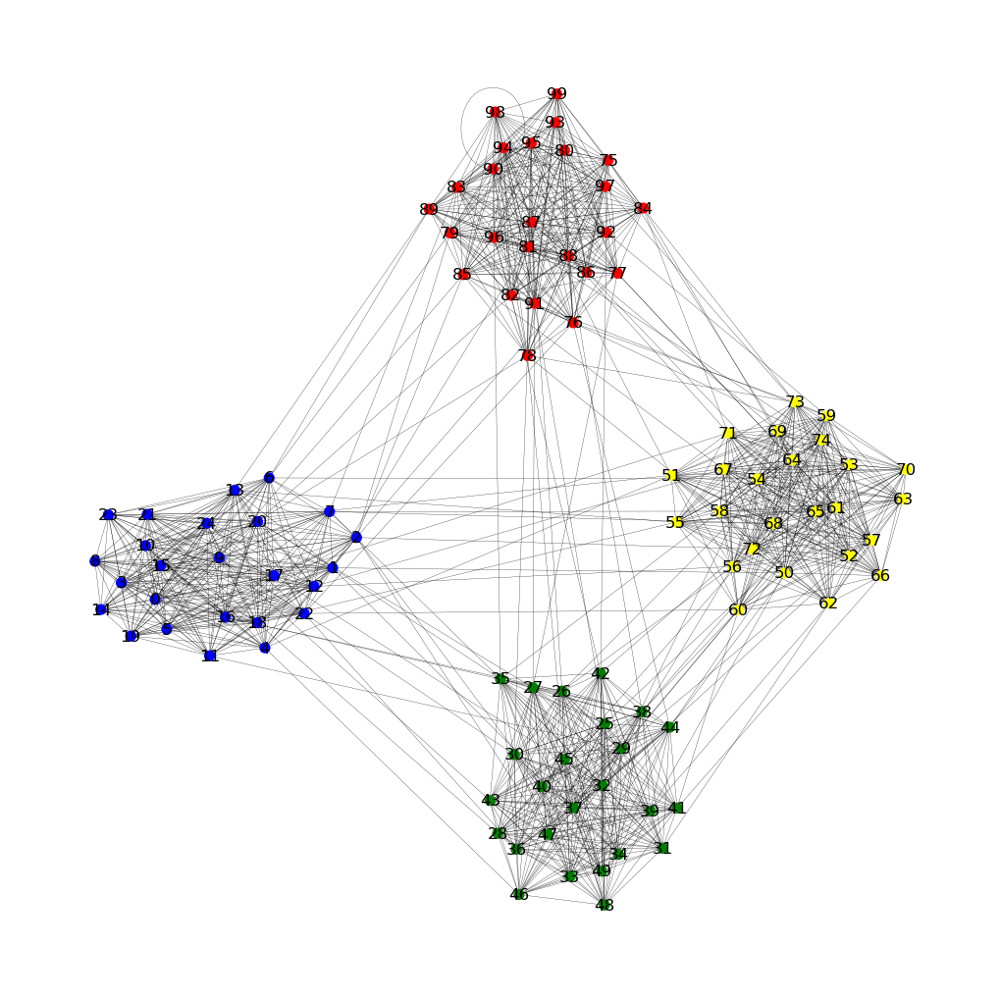

In [496]:
plotter(louvain1)

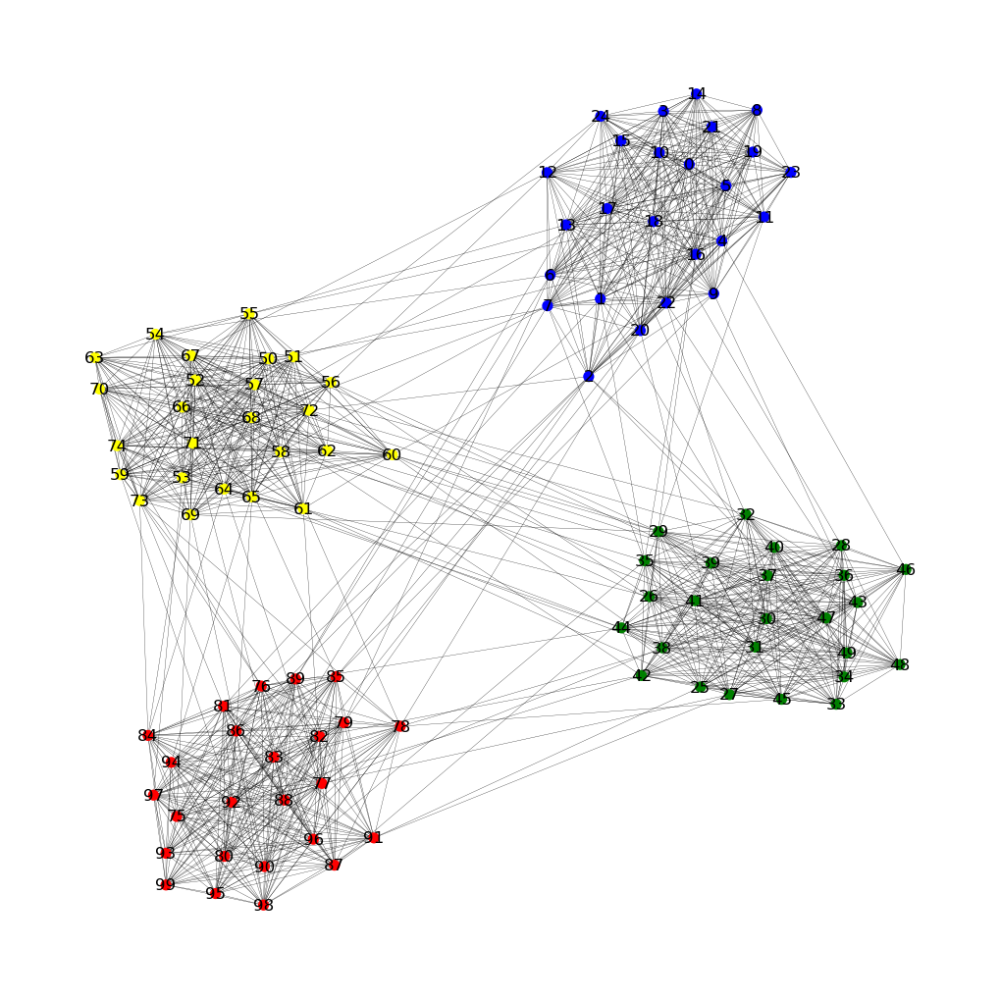

In [498]:
plotter(louvain2)

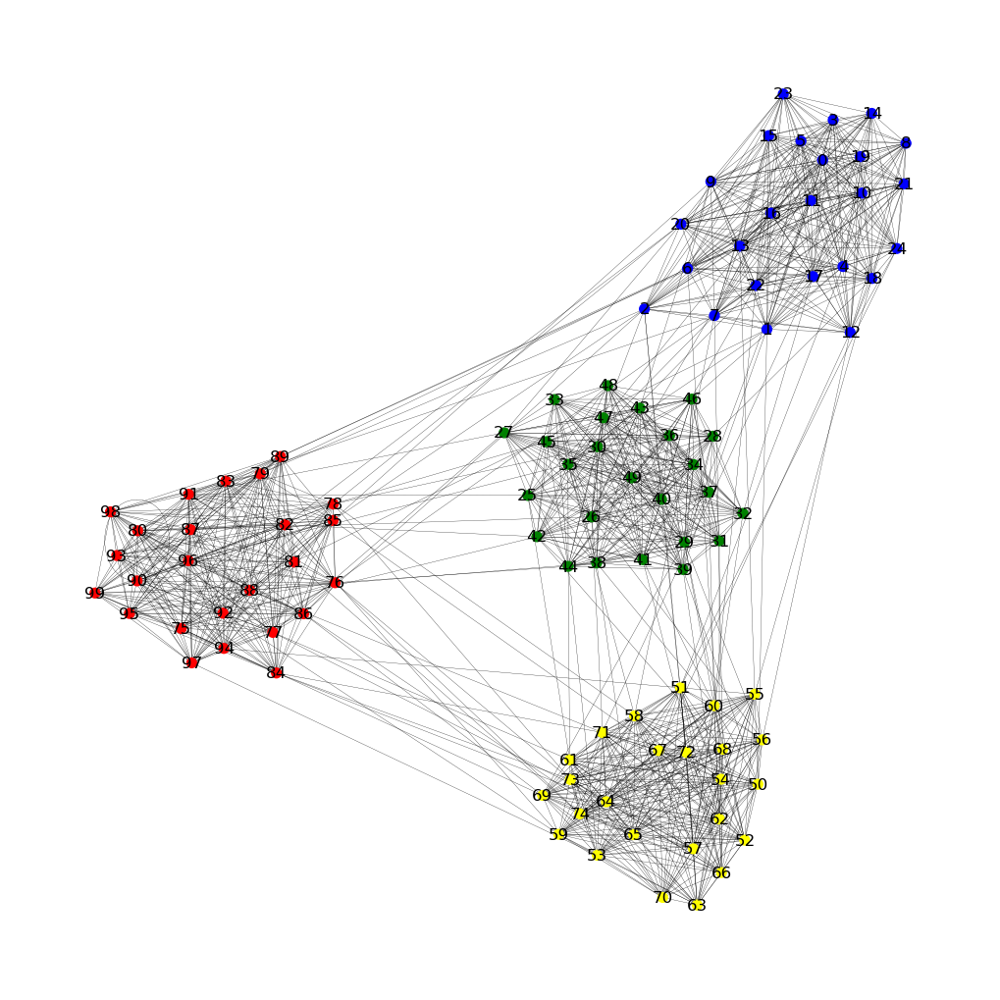

In [497]:
plotter(louvain3)

In [501]:
#apply Girvan-Newman

gn1 = nx.community.girvan_newman(c1)
gn2 = nx.community.girvan_newman(c2)
gn3 = nx.community.girvan_newman(c3)

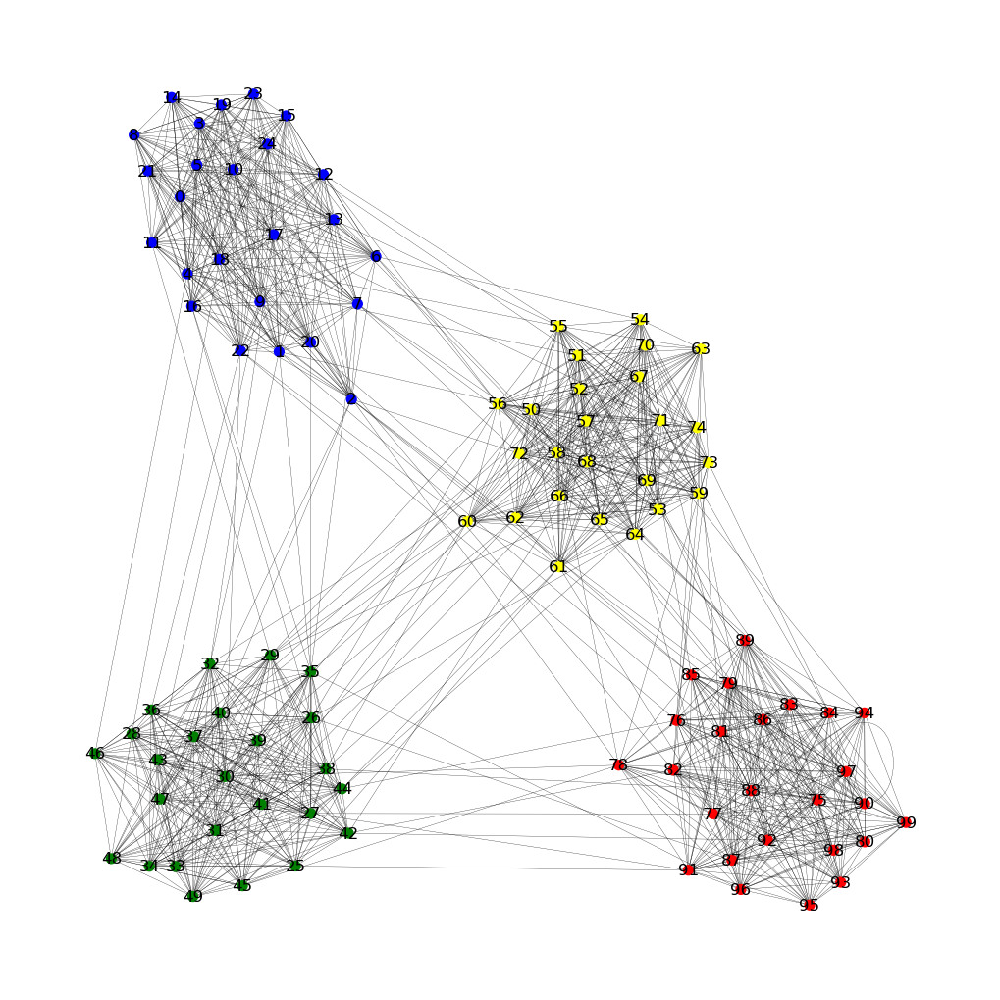

In [499]:
plotter(gn1)

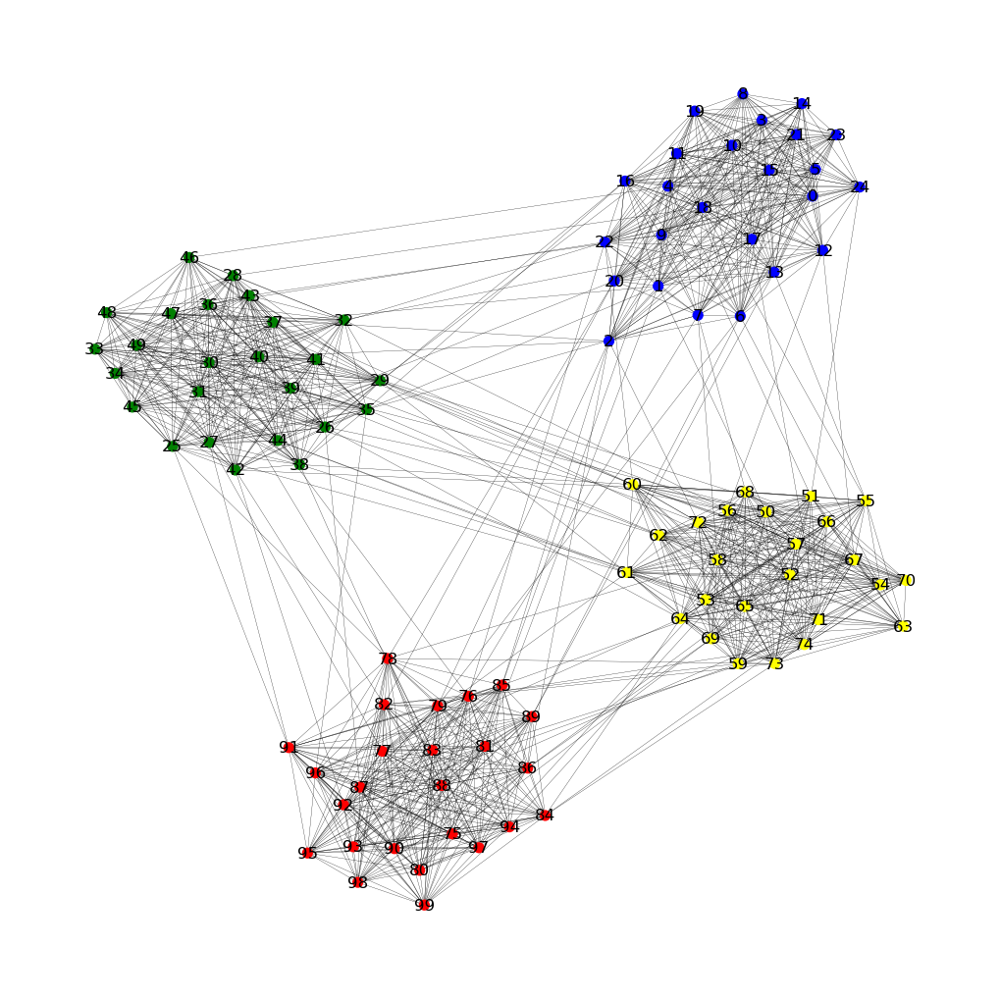

In [502]:
plotter(gn2)

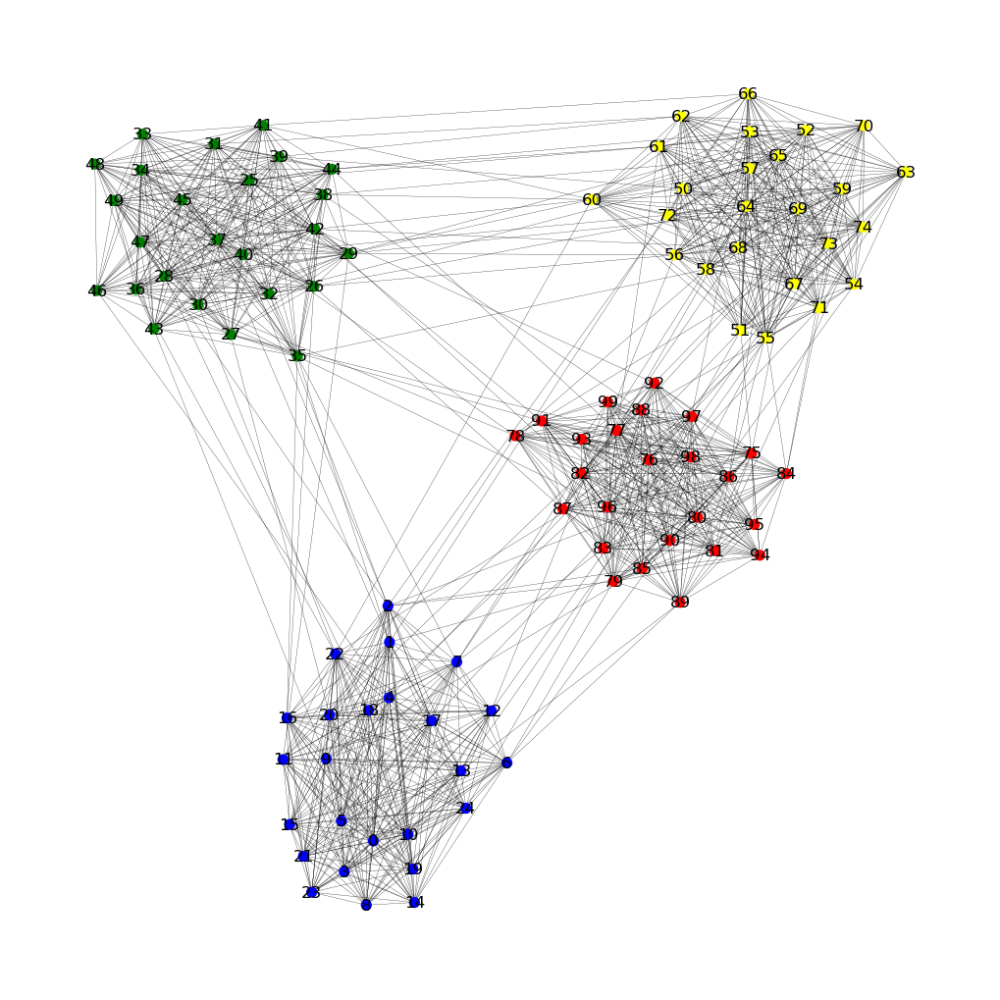

In [504]:
plotter(gn3)

In [511]:
nx_com.modularity(c1,nx_com.louvain_communities(c1))

0.6757802083333333

In [512]:
nx_com.modularity(c2,nx_com.louvain_communities(c2))

0.5882517361111111

In [513]:
nx_com.modularity(c3,nx_com.louvain_communities(c3))

0.40075590277777773

In [533]:
def compute_girvan_newman_modularity(graph):

    communities = girvan_newman(graph)

    node_groups = []
    for com in next(communities):
        node_groups.append(list(com))

    return nx_com.modularity(graph,node_groups)

In [534]:
compute_girvan_newman_modularity(c1)

0.3349500000000001

In [537]:
compute_girvan_newman_modularity(c2)

0.2940541666666666

In [538]:
compute_girvan_newman_modularity(c3)

0.20082083333333325

In [ ]:
# From the modularity scores of the two clustering methods we see 
#that louvain clustering identifies denser, more isolated 
#communities compared to the Girvan_Newman method which yeilds 
#lower scores, indicating less dense, more outwards connected 
#communities In general the score decreases as p increases 
#because there is a higher chance of random rewiring breaking 
#the initial cliques, this also makes sense that with
# more random rewiring the resulting communitites may not be 
#as dense as initial 